<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_tumor_effnet_crop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'


/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [9]:
%cd '/dataset unzipped'

/dataset unzipped


In [10]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [11]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)
image_index = 0
bb_train = np.zeros((len(X_train),4))
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                #print(temp_array)
                bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])
            image_index += 1
            count += 1
X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
bb_test = np.zeros((len(X_test),4))
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])
            image_index += 1
            count_test += 1
print(bb_test[30])
print(extRight_coords_x_test[30])
print(extLeft_coords_x_test[30])

[124.42452099  66.77324418  27.7127405   30.13654925]
383
141


In [ ]:
len(X_train)

In [12]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_effnet')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)

In [17]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou



In [ ]:
#def iou(y_true,y_pred):
  #pred_bbox_val = model.predict(X_val)
  #iou = tf.numpy_function(calculate_iou,[y_true,y_pred],tf.float32)
  #return iou

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
        #img = cv2.rectangle(img, (0,0),(10,10), (0, 0, 255), 1)
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
callbacks_list = [
    ShowTestImages()
]

In [24]:
effnet = EfficientNetB0(weights='imagenet',include_top=False,input_shape=(image_size,image_size,3))
model = effnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dropout(rate=0.5)(model)
model = tf.keras.layers.Flatten()(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=effnet.inputs, outputs = model)

In [25]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/100
7/7 [==============================] - 0s 36ms/step


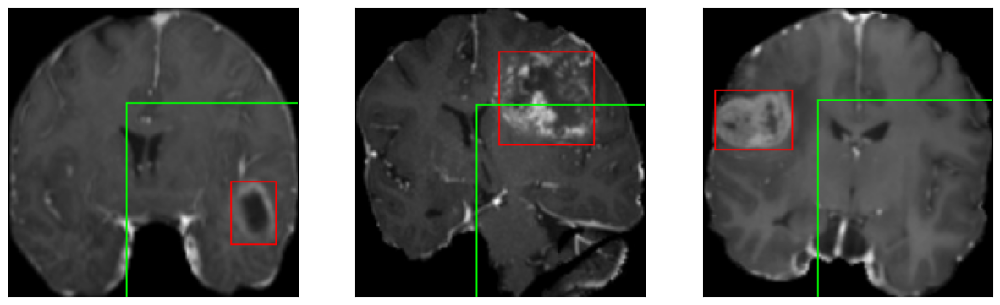

50/50 [==============================] - 65s 263ms/step - loss: 52.1434 - IoU: 8.5230e-04 - val_loss: 61.9984 - val_IoU: 0.0636
Epoch 2/100
7/7 [==============================] - 0s 36ms/step


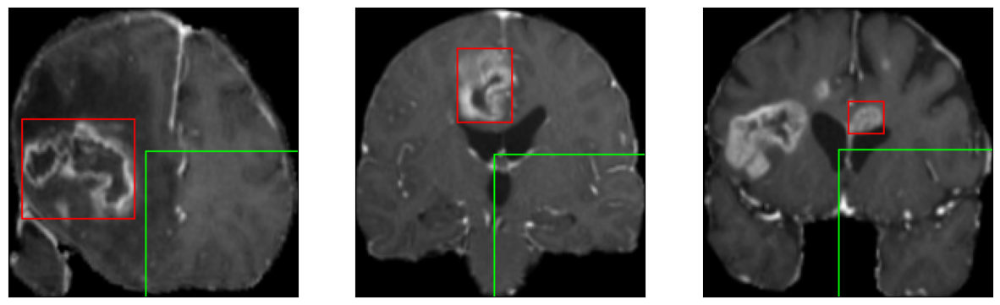

50/50 [==============================] - 7s 134ms/step - loss: 29.7771 - IoU: 0.0401 - val_loss: 55.0611 - val_IoU: 0.0458
Epoch 3/100
7/7 [==============================] - 0s 36ms/step


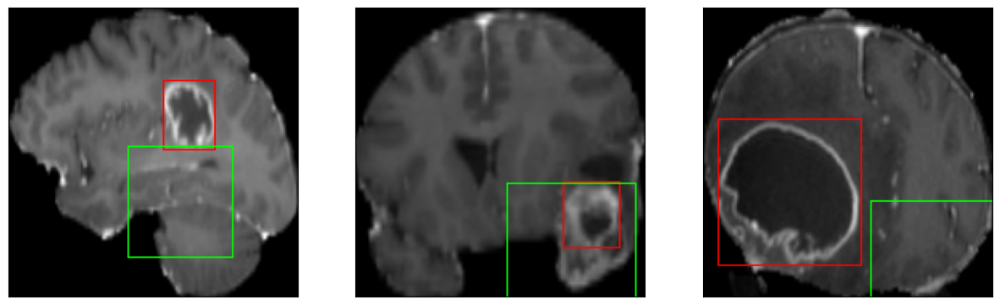

50/50 [==============================] - 7s 130ms/step - loss: 21.1273 - IoU: 0.1087 - val_loss: 36.3106 - val_IoU: 0.0375
Epoch 4/100
7/7 [==============================] - 0s 38ms/step


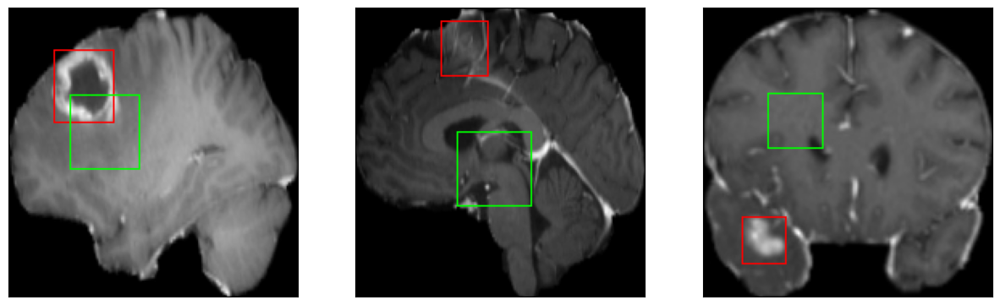

50/50 [==============================] - 7s 140ms/step - loss: 18.0395 - IoU: 0.1330 - val_loss: 17.9663 - val_IoU: 0.1478
Epoch 5/100
7/7 [==============================] - 0s 36ms/step


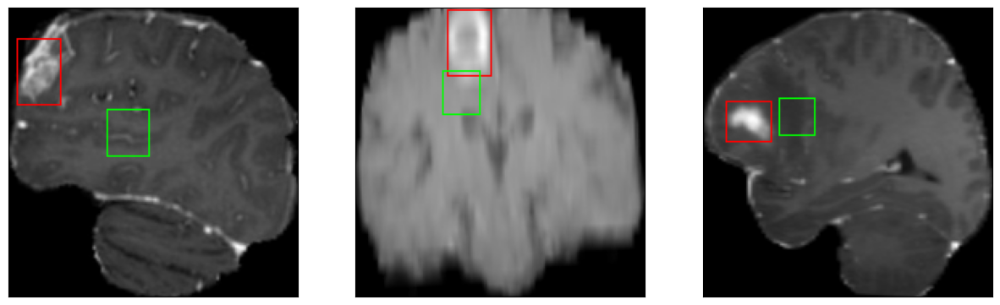

50/50 [==============================] - 7s 131ms/step - loss: 14.5850 - IoU: 0.2023 - val_loss: 14.2089 - val_IoU: 0.1619
Epoch 6/100
7/7 [==============================] - 0s 36ms/step


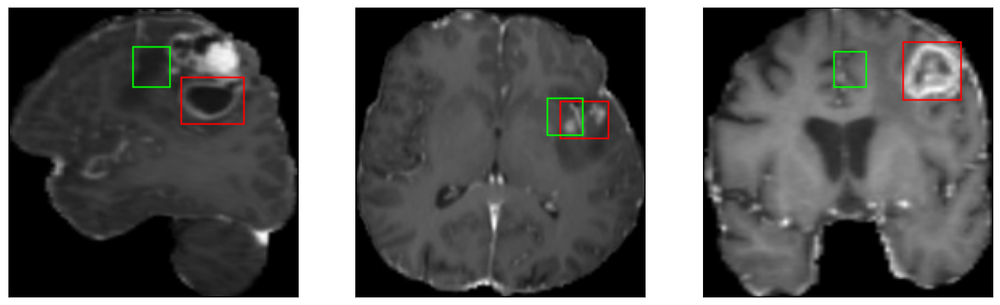

50/50 [==============================] - 7s 136ms/step - loss: 10.7873 - IoU: 0.3049 - val_loss: 10.0841 - val_IoU: 0.3552
Epoch 7/100
7/7 [==============================] - 0s 38ms/step


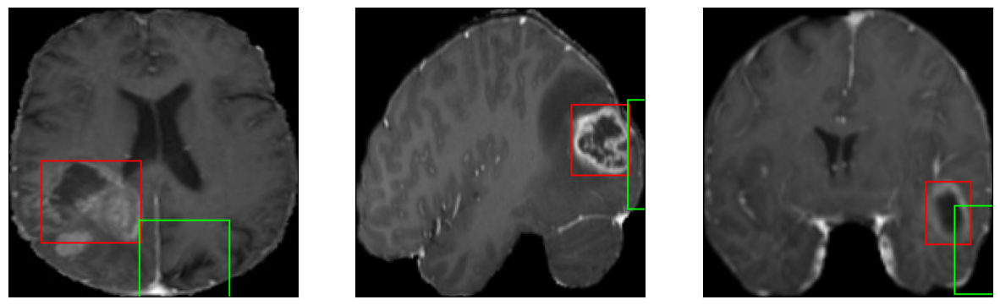

50/50 [==============================] - 7s 140ms/step - loss: 9.7022 - IoU: 0.3437 - val_loss: 22.3687 - val_IoU: 0.0781
Epoch 8/100
7/7 [==============================] - 0s 38ms/step


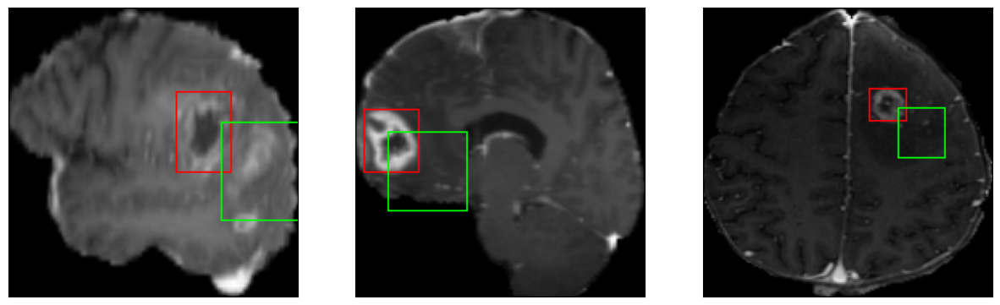

50/50 [==============================] - 7s 134ms/step - loss: 9.0694 - IoU: 0.3743 - val_loss: 16.2387 - val_IoU: 0.2088
Epoch 9/100
7/7 [==============================] - 0s 37ms/step


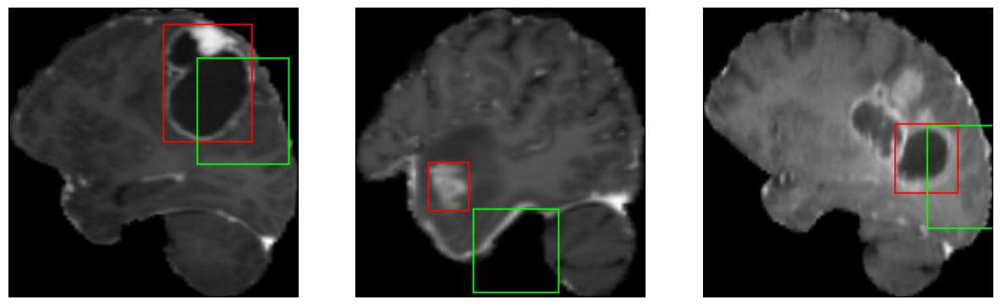

50/50 [==============================] - 7s 130ms/step - loss: 8.4422 - IoU: 0.3950 - val_loss: 21.7932 - val_IoU: 0.0531
Epoch 10/100
7/7 [==============================] - 0s 38ms/step


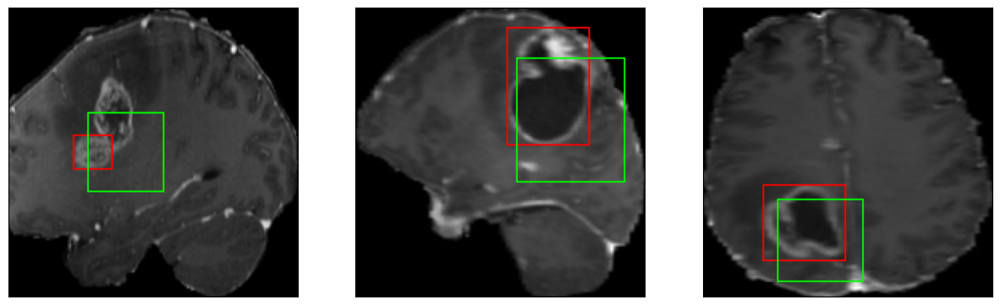

50/50 [==============================] - 7s 142ms/step - loss: 8.1893 - IoU: 0.3929 - val_loss: 14.0073 - val_IoU: 0.2804
Epoch 11/100
7/7 [==============================] - 0s 38ms/step


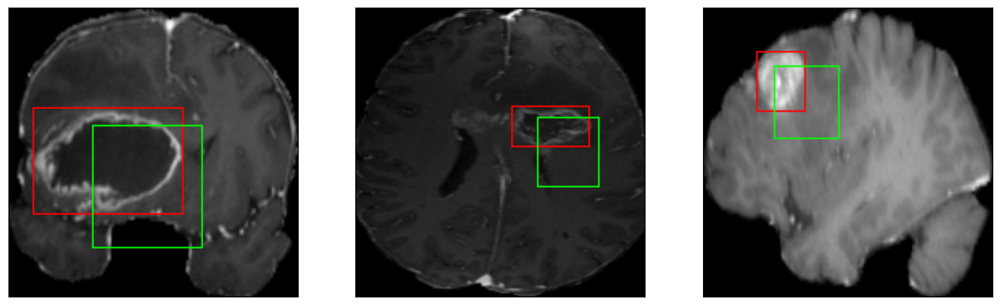

50/50 [==============================] - 7s 130ms/step - loss: 7.4686 - IoU: 0.4423 - val_loss: 11.7510 - val_IoU: 0.2478
Epoch 12/100
7/7 [==============================] - 0s 37ms/step


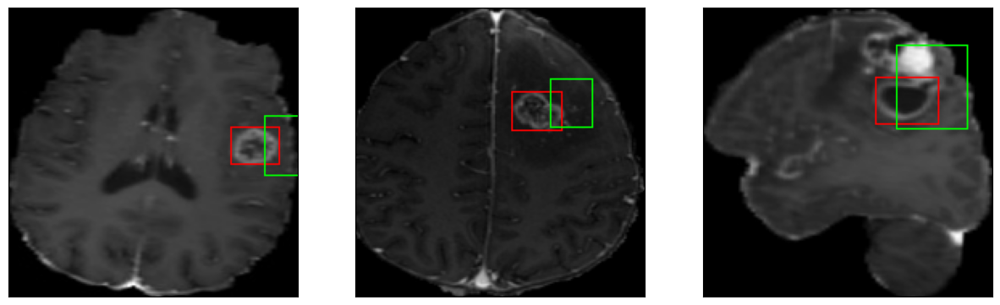

50/50 [==============================] - 7s 143ms/step - loss: 7.5704 - IoU: 0.4254 - val_loss: 10.5813 - val_IoU: 0.2631
Epoch 13/100
7/7 [==============================] - 0s 40ms/step


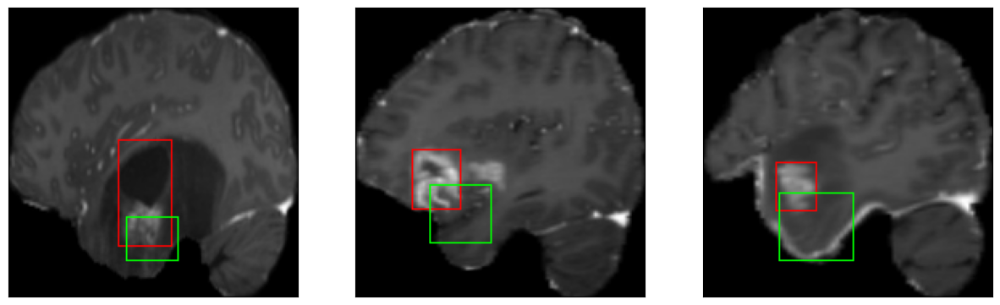

50/50 [==============================] - 7s 136ms/step - loss: 7.1604 - IoU: 0.4481 - val_loss: 8.7647 - val_IoU: 0.3849
Epoch 14/100
7/7 [==============================] - 0s 38ms/step


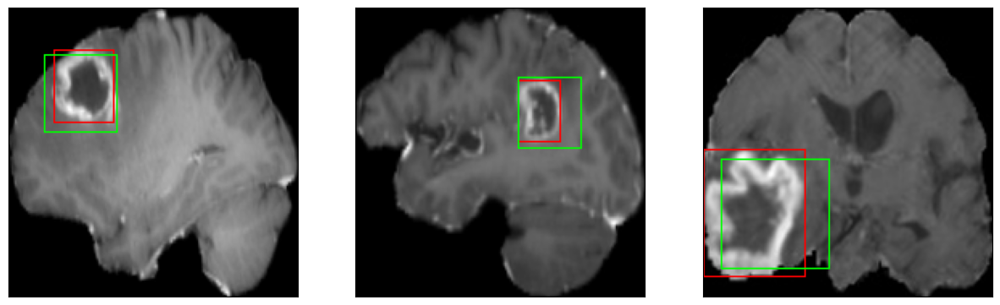

50/50 [==============================] - 7s 132ms/step - loss: 7.2992 - IoU: 0.4437 - val_loss: 6.4570 - val_IoU: 0.5757
Epoch 15/100
7/7 [==============================] - 0s 37ms/step


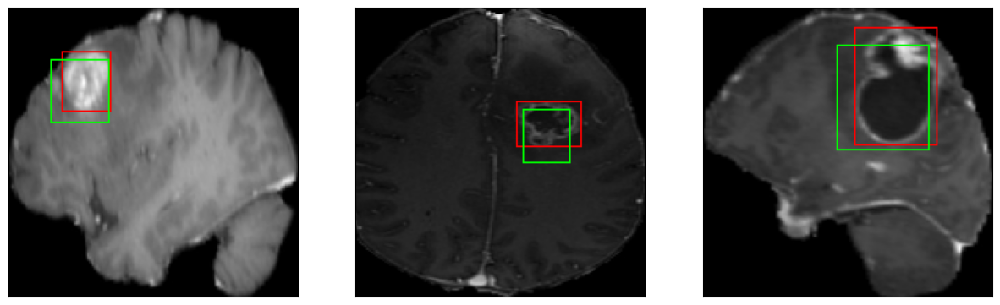

50/50 [==============================] - 7s 135ms/step - loss: 6.5999 - IoU: 0.4837 - val_loss: 7.0345 - val_IoU: 0.4964
Epoch 16/100
7/7 [==============================] - 0s 38ms/step


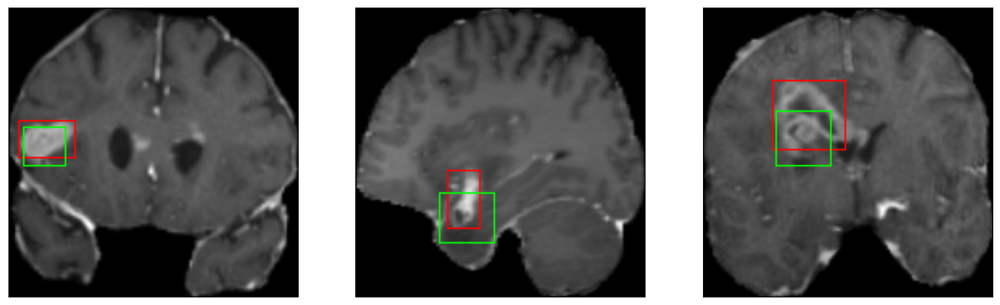

50/50 [==============================] - 7s 143ms/step - loss: 6.4314 - IoU: 0.4935 - val_loss: 6.5691 - val_IoU: 0.4778
Epoch 17/100
7/7 [==============================] - 0s 38ms/step


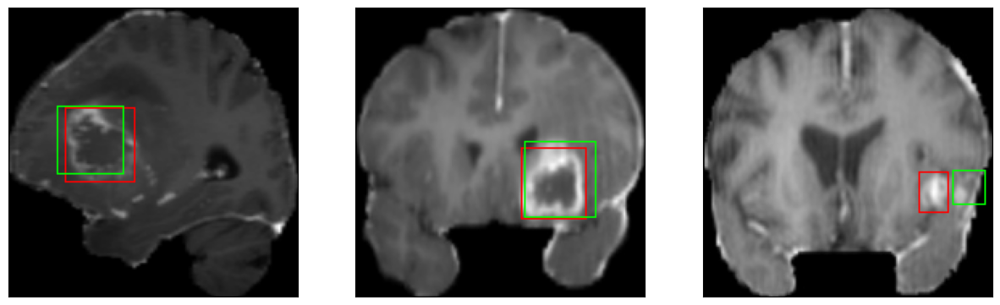

50/50 [==============================] - 7s 135ms/step - loss: 6.4168 - IoU: 0.5092 - val_loss: 5.2108 - val_IoU: 0.6165
Epoch 18/100
7/7 [==============================] - 0s 38ms/step


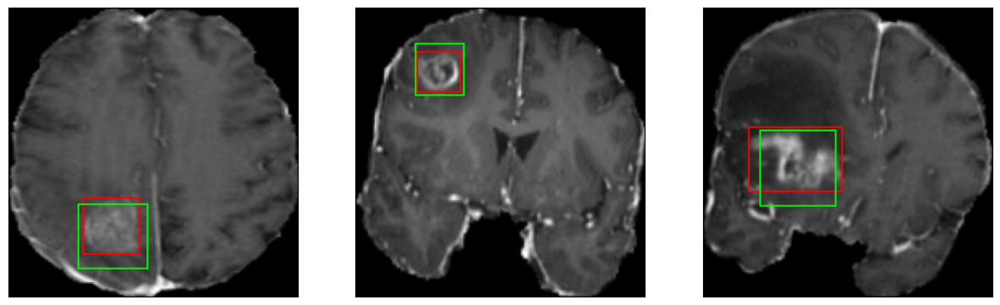

50/50 [==============================] - 7s 135ms/step - loss: 6.4466 - IoU: 0.4985 - val_loss: 5.5621 - val_IoU: 0.6463
Epoch 19/100
7/7 [==============================] - 0s 39ms/step


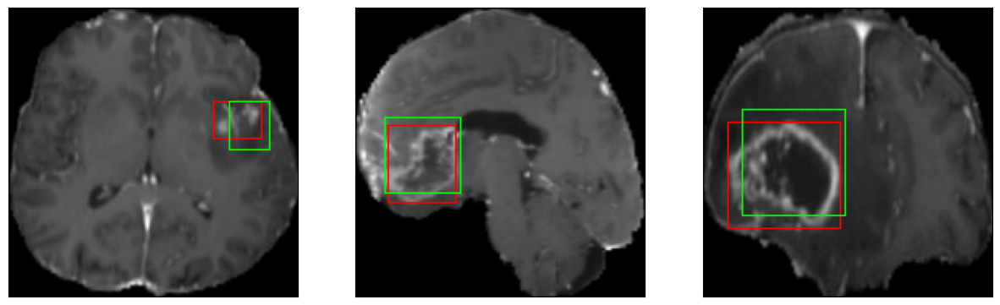

50/50 [==============================] - 7s 149ms/step - loss: 6.3035 - IoU: 0.5015 - val_loss: 5.0167 - val_IoU: 0.6102
Epoch 20/100
7/7 [==============================] - 0s 38ms/step


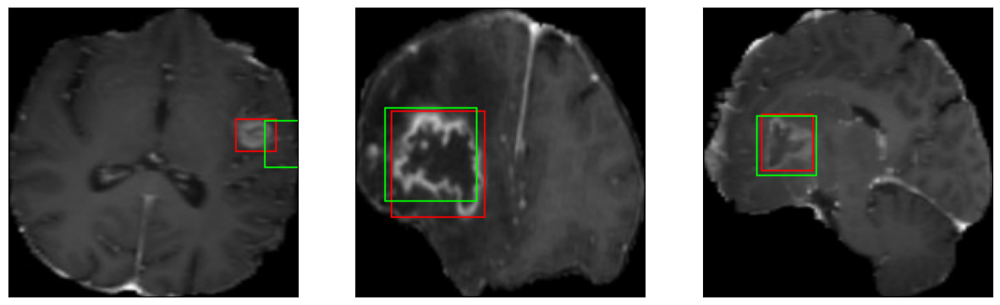

50/50 [==============================] - 7s 137ms/step - loss: 6.4397 - IoU: 0.4910 - val_loss: 5.7555 - val_IoU: 0.5596
Epoch 21/100
7/7 [==============================] - 0s 37ms/step


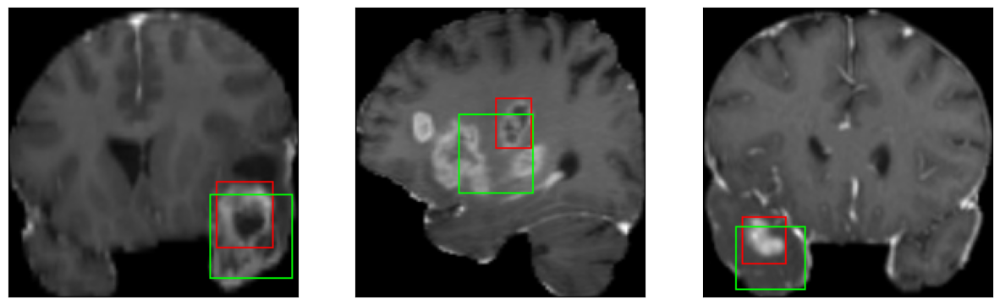

50/50 [==============================] - 7s 147ms/step - loss: 5.8066 - IoU: 0.5385 - val_loss: 8.1986 - val_IoU: 0.5051
Epoch 22/100
7/7 [==============================] - 0s 39ms/step


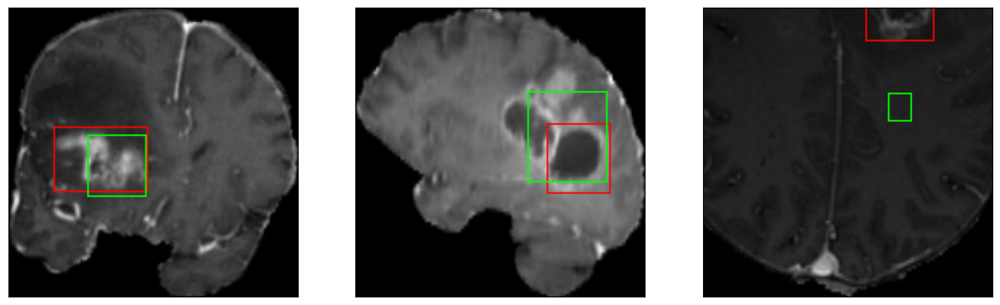

50/50 [==============================] - 7s 136ms/step - loss: 5.8547 - IoU: 0.5370 - val_loss: 6.5170 - val_IoU: 0.5122
Epoch 23/100
7/7 [==============================] - 0s 39ms/step


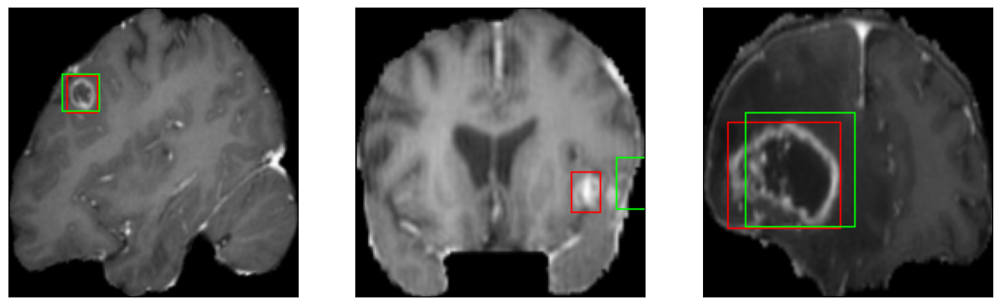

50/50 [==============================] - 7s 145ms/step - loss: 5.9336 - IoU: 0.5344 - val_loss: 6.6469 - val_IoU: 0.5034
Epoch 24/100
7/7 [==============================] - 0s 41ms/step


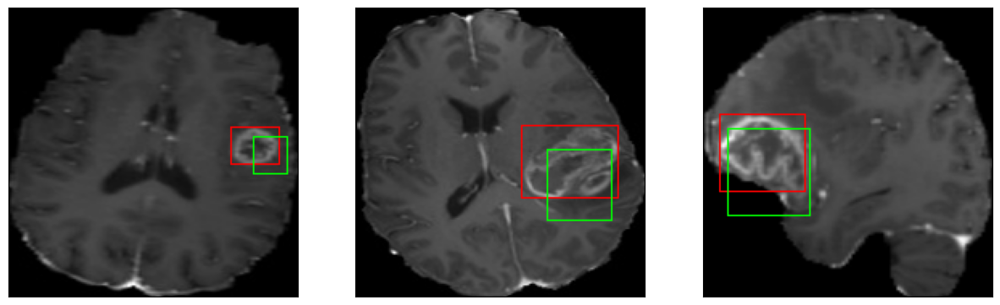

50/50 [==============================] - 7s 139ms/step - loss: 5.7690 - IoU: 0.5355 - val_loss: 6.5549 - val_IoU: 0.4860
Epoch 25/100
7/7 [==============================] - 0s 38ms/step


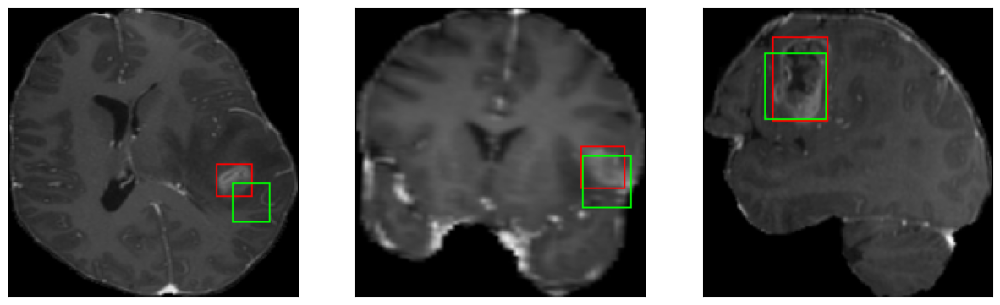

50/50 [==============================] - 7s 135ms/step - loss: 5.6677 - IoU: 0.5427 - val_loss: 5.7050 - val_IoU: 0.5620
Epoch 26/100
7/7 [==============================] - 0s 39ms/step


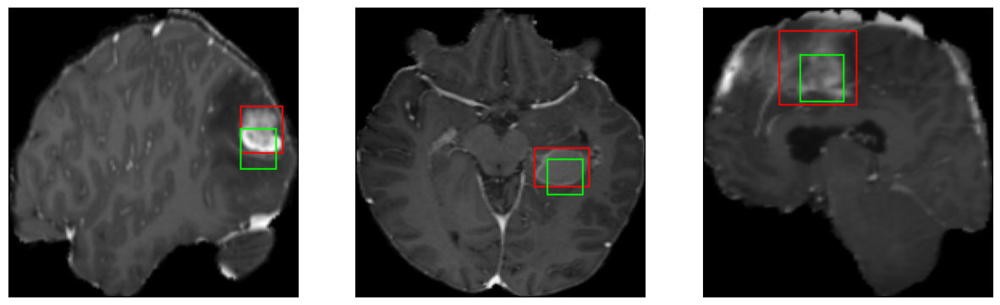

50/50 [==============================] - 7s 140ms/step - loss: 5.7129 - IoU: 0.5503 - val_loss: 7.8570 - val_IoU: 0.4152
Epoch 27/100
7/7 [==============================] - 0s 40ms/step


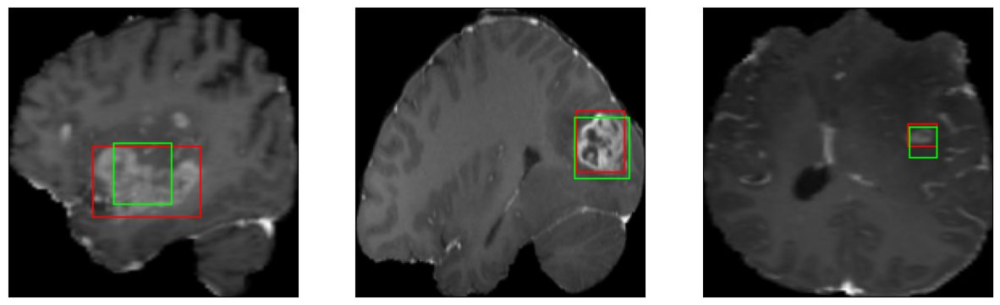

50/50 [==============================] - 8s 151ms/step - loss: 5.6675 - IoU: 0.5452 - val_loss: 5.4672 - val_IoU: 0.6063
Epoch 28/100
7/7 [==============================] - 0s 41ms/step


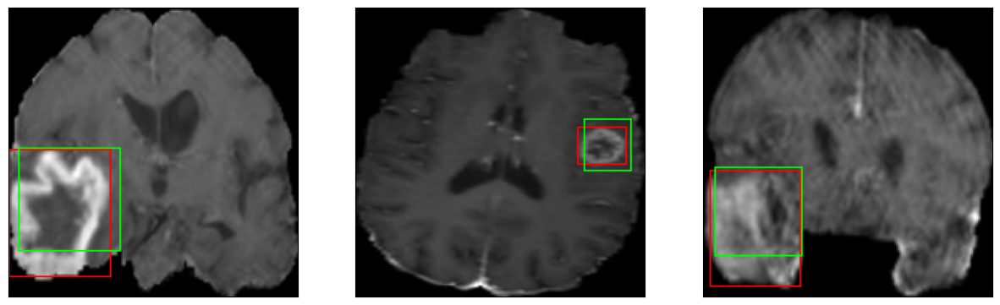

50/50 [==============================] - 7s 141ms/step - loss: 5.2898 - IoU: 0.5773 - val_loss: 5.0590 - val_IoU: 0.6507
Epoch 29/100
7/7 [==============================] - 0s 38ms/step


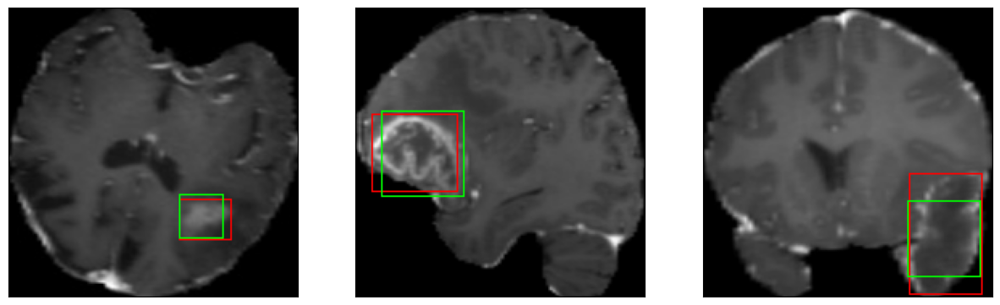

50/50 [==============================] - 7s 137ms/step - loss: 5.3519 - IoU: 0.5677 - val_loss: 3.9400 - val_IoU: 0.7109
Epoch 30/100
7/7 [==============================] - 0s 40ms/step


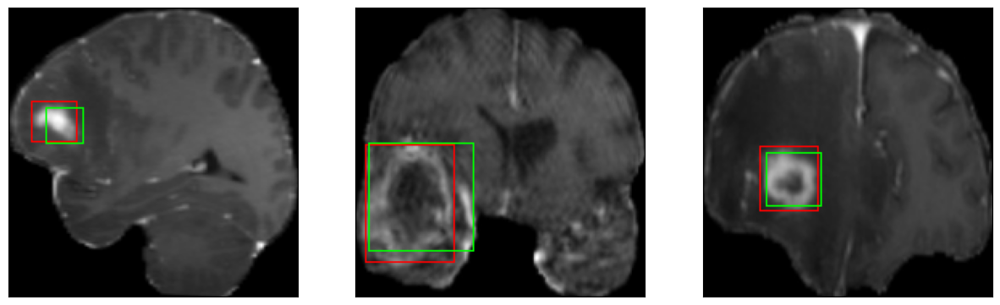

50/50 [==============================] - 8s 157ms/step - loss: 5.3309 - IoU: 0.5760 - val_loss: 5.4115 - val_IoU: 0.5791
Epoch 31/100
7/7 [==============================] - 0s 38ms/step


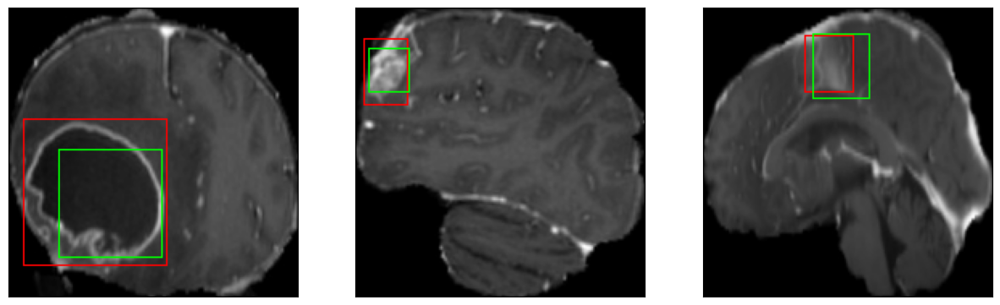

50/50 [==============================] - 7s 139ms/step - loss: 5.3793 - IoU: 0.5748 - val_loss: 6.0189 - val_IoU: 0.5217
Epoch 32/100
7/7 [==============================] - 0s 38ms/step


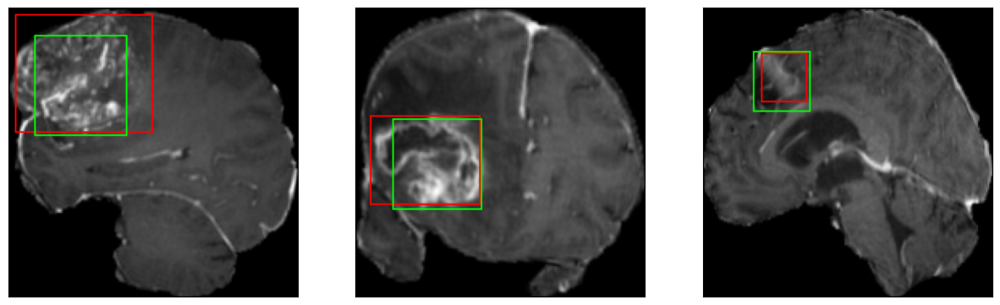

50/50 [==============================] - 8s 161ms/step - loss: 5.2947 - IoU: 0.5758 - val_loss: 4.2425 - val_IoU: 0.6912
Epoch 33/100
7/7 [==============================] - 0s 39ms/step


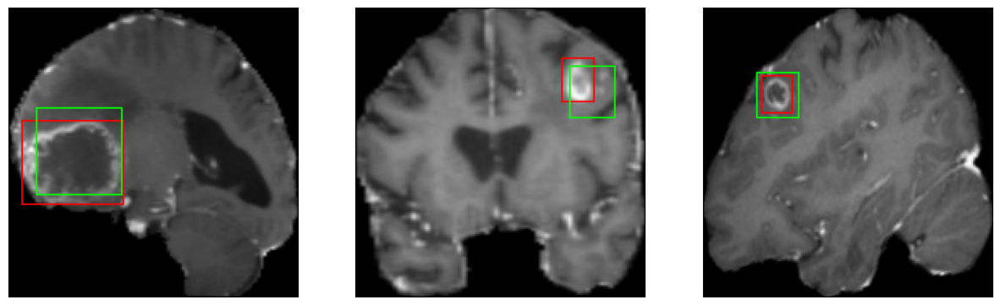

50/50 [==============================] - 7s 139ms/step - loss: 4.9592 - IoU: 0.5931 - val_loss: 4.9320 - val_IoU: 0.6417
Epoch 34/100
7/7 [==============================] - 0s 39ms/step


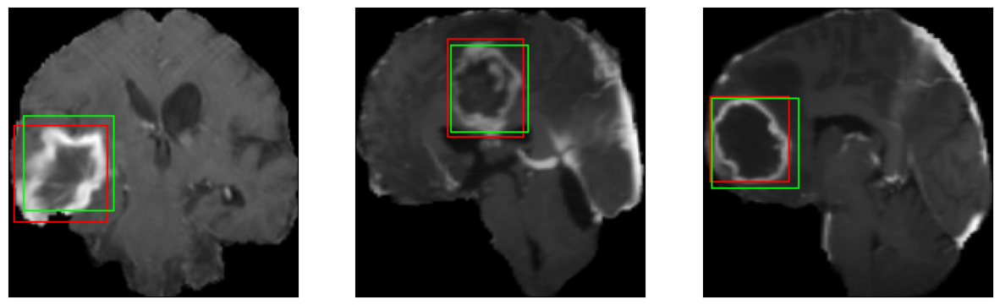

50/50 [==============================] - 8s 157ms/step - loss: 5.2186 - IoU: 0.5767 - val_loss: 4.9198 - val_IoU: 0.6139
Epoch 35/100
7/7 [==============================] - 0s 42ms/step


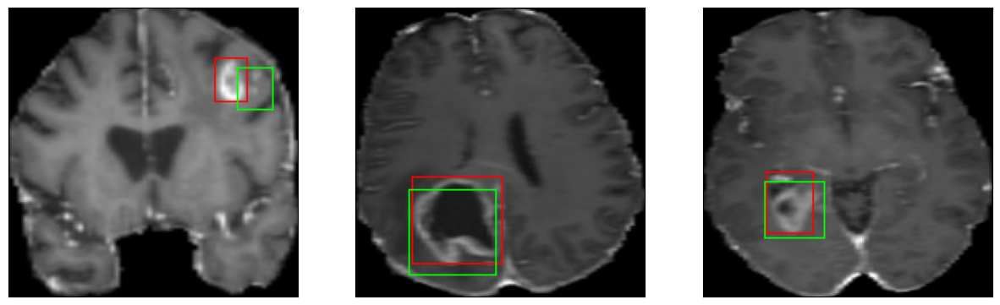

50/50 [==============================] - 7s 141ms/step - loss: 5.0629 - IoU: 0.5886 - val_loss: 4.7306 - val_IoU: 0.6384
Epoch 36/100
7/7 [==============================] - 0s 37ms/step


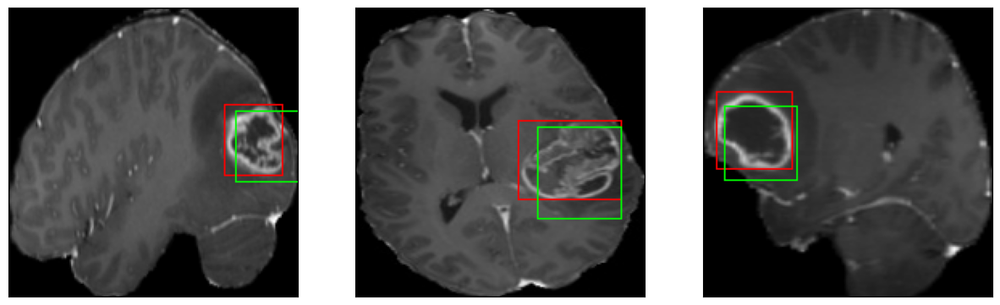

50/50 [==============================] - 8s 153ms/step - loss: 4.9361 - IoU: 0.6027 - val_loss: 6.1299 - val_IoU: 0.5140
Epoch 37/100
7/7 [==============================] - 0s 38ms/step


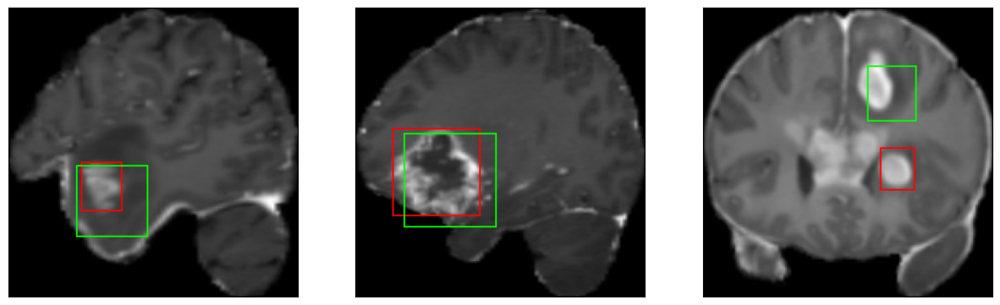

50/50 [==============================] - 7s 141ms/step - loss: 5.1011 - IoU: 0.5931 - val_loss: 5.3515 - val_IoU: 0.6370
Epoch 38/100
7/7 [==============================] - 0s 38ms/step


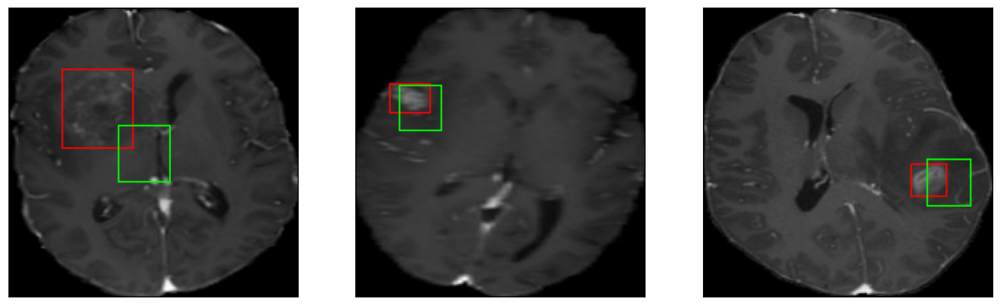

50/50 [==============================] - 7s 140ms/step - loss: 5.1584 - IoU: 0.5885 - val_loss: 6.0761 - val_IoU: 0.5513
Epoch 39/100
7/7 [==============================] - 0s 39ms/step


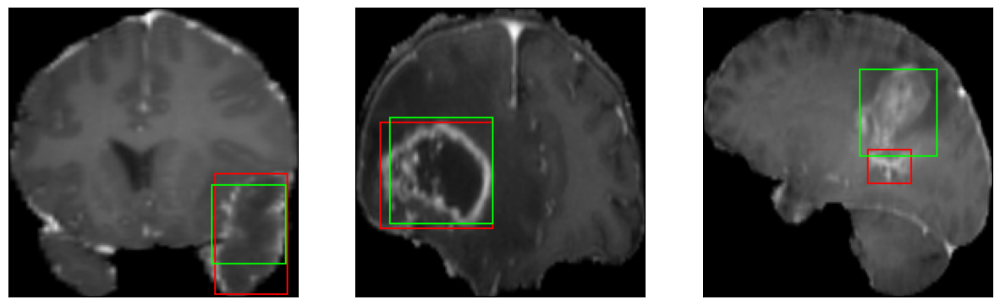

50/50 [==============================] - 8s 156ms/step - loss: 5.0170 - IoU: 0.5960 - val_loss: 3.9179 - val_IoU: 0.7225
Epoch 40/100
7/7 [==============================] - 0s 39ms/step


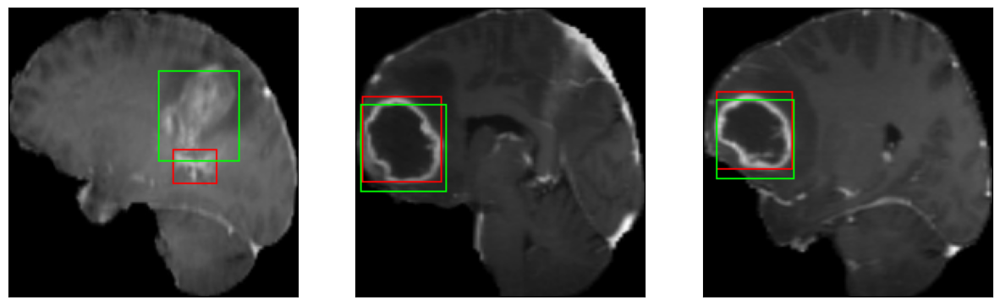

50/50 [==============================] - 7s 138ms/step - loss: 4.8653 - IoU: 0.6112 - val_loss: 4.1912 - val_IoU: 0.7034
Epoch 41/100
7/7 [==============================] - 0s 39ms/step


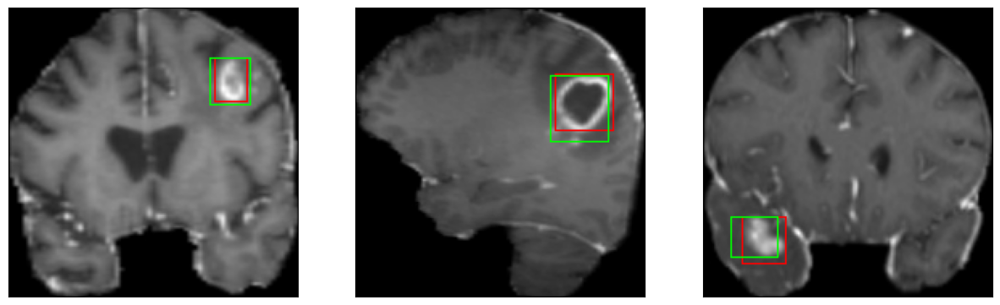

50/50 [==============================] - 8s 160ms/step - loss: 4.7888 - IoU: 0.6155 - val_loss: 4.6539 - val_IoU: 0.6608
Epoch 42/100
7/7 [==============================] - 0s 39ms/step


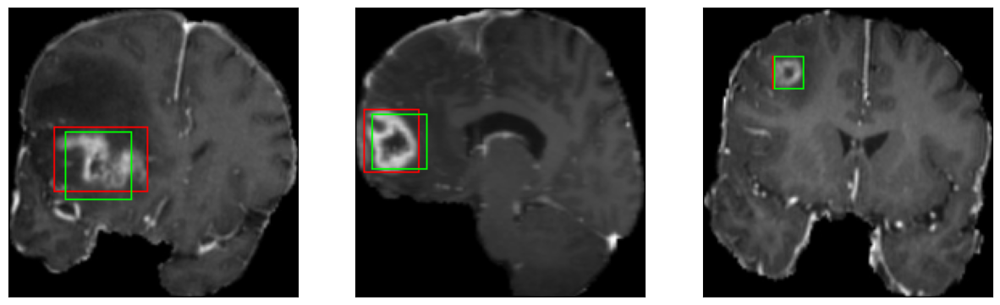

50/50 [==============================] - 7s 147ms/step - loss: 4.6178 - IoU: 0.6262 - val_loss: 4.8120 - val_IoU: 0.6601
Epoch 43/100
7/7 [==============================] - 0s 38ms/step


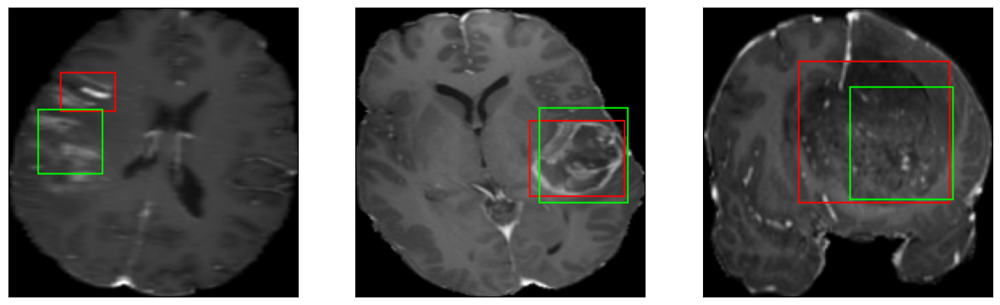

50/50 [==============================] - 7s 141ms/step - loss: 4.9001 - IoU: 0.6102 - val_loss: 4.7225 - val_IoU: 0.6646
Epoch 44/100
7/7 [==============================] - 0s 38ms/step


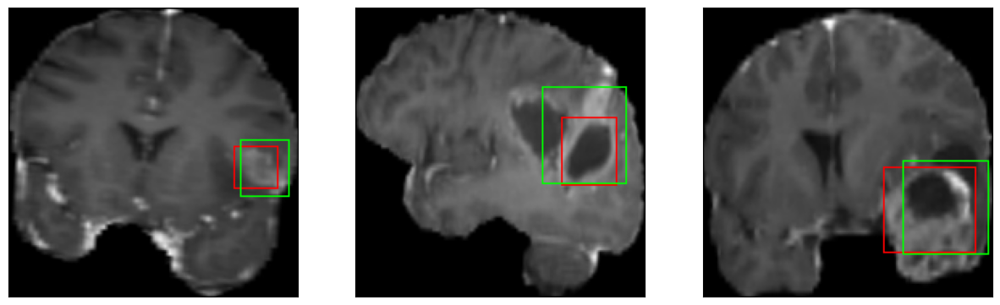

50/50 [==============================] - 8s 154ms/step - loss: 4.7840 - IoU: 0.6132 - val_loss: 4.3620 - val_IoU: 0.6662
Epoch 45/100
7/7 [==============================] - 0s 38ms/step


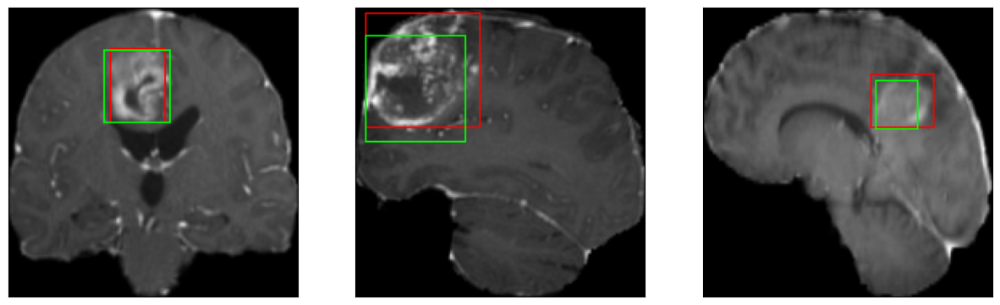

50/50 [==============================] - 7s 144ms/step - loss: 4.9525 - IoU: 0.6020 - val_loss: 4.5202 - val_IoU: 0.6852
Epoch 46/100
7/7 [==============================] - 0s 38ms/step


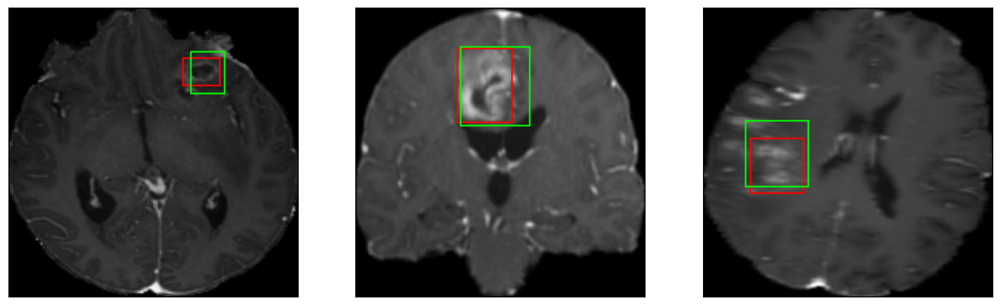

50/50 [==============================] - 7s 141ms/step - loss: 4.7508 - IoU: 0.6200 - val_loss: 5.5225 - val_IoU: 0.6197
Epoch 47/100
7/7 [==============================] - 0s 39ms/step


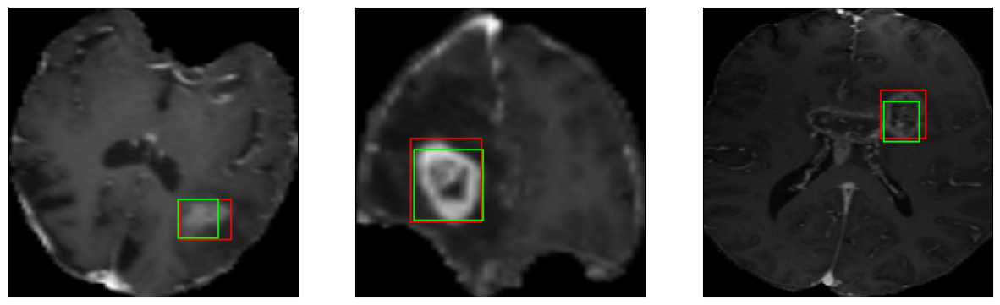

50/50 [==============================] - 7s 149ms/step - loss: 4.5746 - IoU: 0.6328 - val_loss: 4.1337 - val_IoU: 0.6781
Epoch 48/100
7/7 [==============================] - 0s 40ms/step


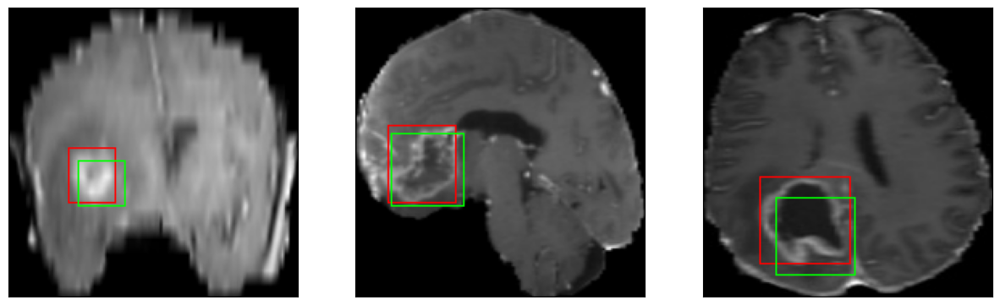

50/50 [==============================] - 8s 154ms/step - loss: 4.7703 - IoU: 0.6208 - val_loss: 6.4090 - val_IoU: 0.5490
Epoch 49/100
7/7 [==============================] - 0s 39ms/step


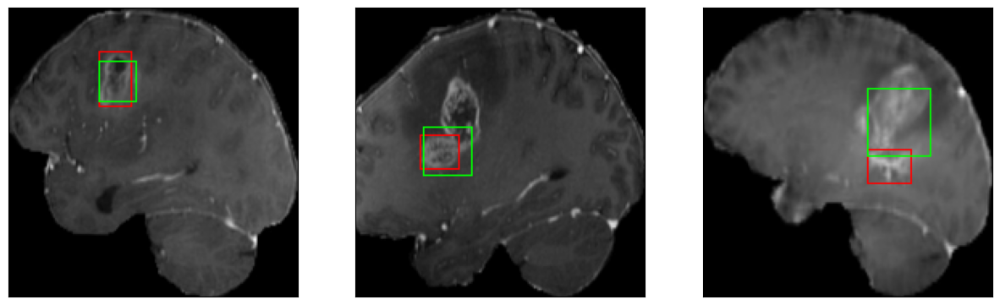

50/50 [==============================] - 7s 150ms/step - loss: 4.7455 - IoU: 0.6193 - val_loss: 8.1120 - val_IoU: 0.4432
Epoch 50/100
7/7 [==============================] - 0s 39ms/step


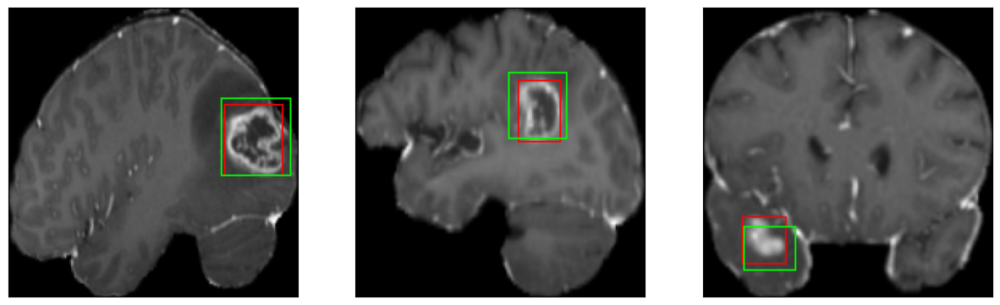

50/50 [==============================] - 8s 158ms/step - loss: 4.6312 - IoU: 0.6319 - val_loss: 4.4609 - val_IoU: 0.6764
Epoch 51/100
7/7 [==============================] - 0s 39ms/step


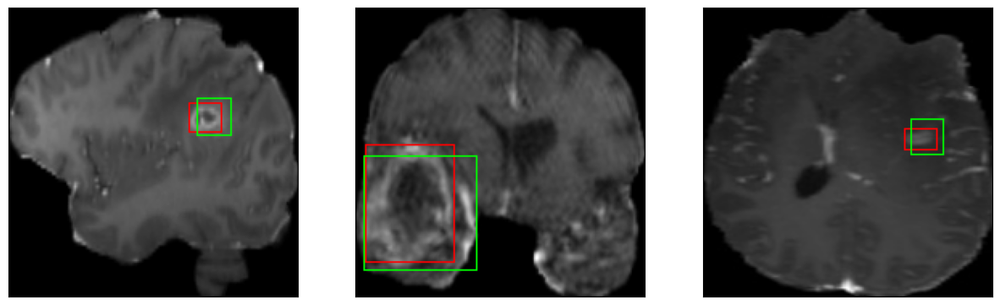

50/50 [==============================] - 7s 147ms/step - loss: 4.7166 - IoU: 0.6180 - val_loss: 4.8359 - val_IoU: 0.6568
Epoch 52/100
7/7 [==============================] - 0s 39ms/step


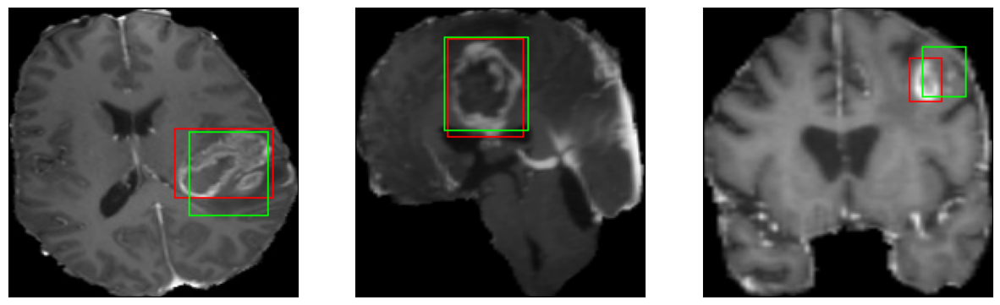

50/50 [==============================] - 8s 158ms/step - loss: 4.5029 - IoU: 0.6346 - val_loss: 4.5925 - val_IoU: 0.6905
Epoch 53/100
7/7 [==============================] - 0s 41ms/step


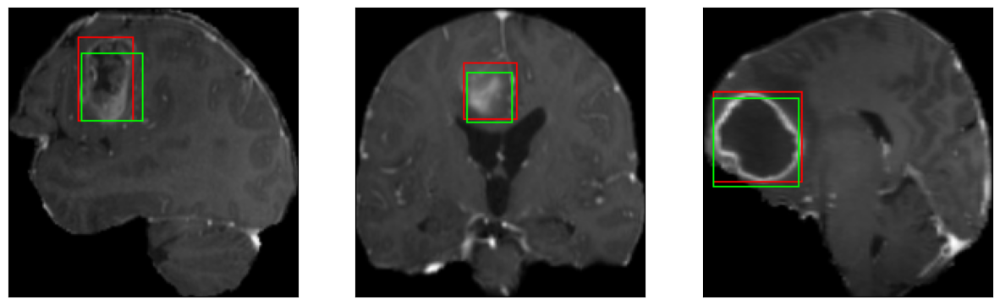

50/50 [==============================] - 7s 148ms/step - loss: 4.6693 - IoU: 0.6249 - val_loss: 5.4853 - val_IoU: 0.5756
Epoch 54/100
7/7 [==============================] - 0s 38ms/step


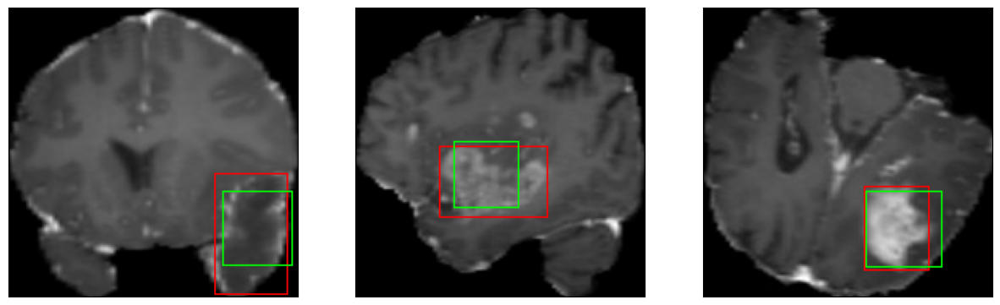

50/50 [==============================] - 7s 144ms/step - loss: 4.6819 - IoU: 0.6232 - val_loss: 5.2702 - val_IoU: 0.5915
Epoch 55/100
7/7 [==============================] - 0s 37ms/step


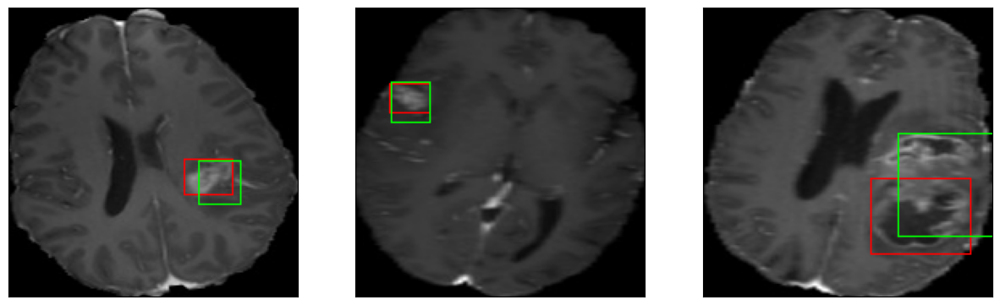

50/50 [==============================] - 8s 152ms/step - loss: 4.7456 - IoU: 0.6164 - val_loss: 5.1167 - val_IoU: 0.5980
Epoch 56/100
7/7 [==============================] - 0s 39ms/step


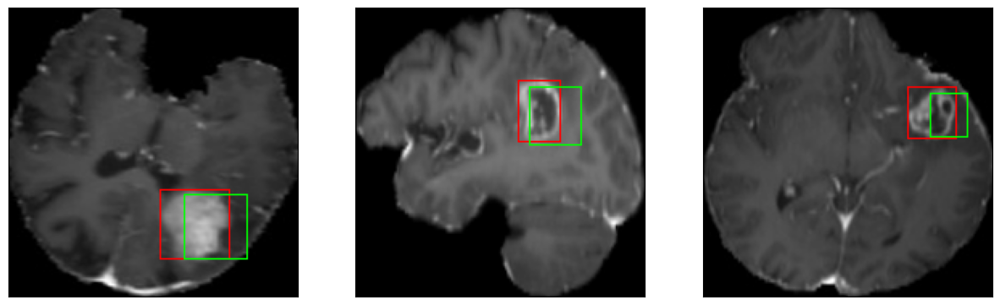

50/50 [==============================] - 7s 146ms/step - loss: 4.7084 - IoU: 0.6215 - val_loss: 6.1839 - val_IoU: 0.5215
Epoch 57/100
7/7 [==============================] - 0s 38ms/step


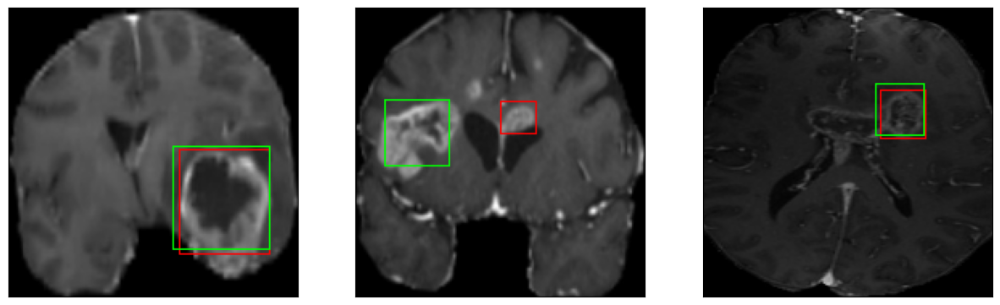

50/50 [==============================] - 8s 154ms/step - loss: 4.5779 - IoU: 0.6321 - val_loss: 4.3132 - val_IoU: 0.6708
Epoch 58/100
7/7 [==============================] - 0s 39ms/step


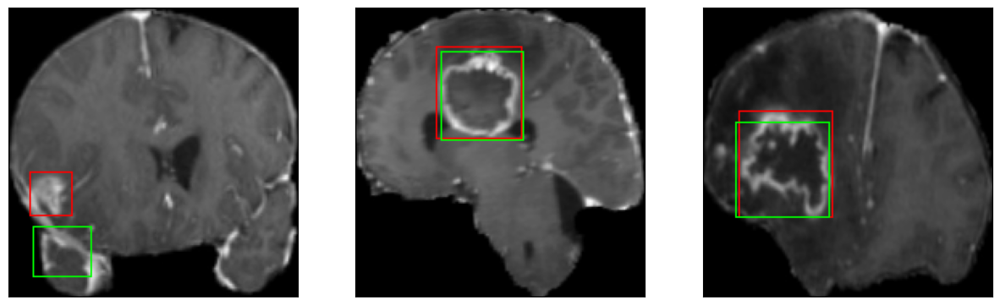

50/50 [==============================] - 7s 149ms/step - loss: 4.7573 - IoU: 0.6167 - val_loss: 5.3026 - val_IoU: 0.5960
Epoch 59/100
7/7 [==============================] - 0s 39ms/step


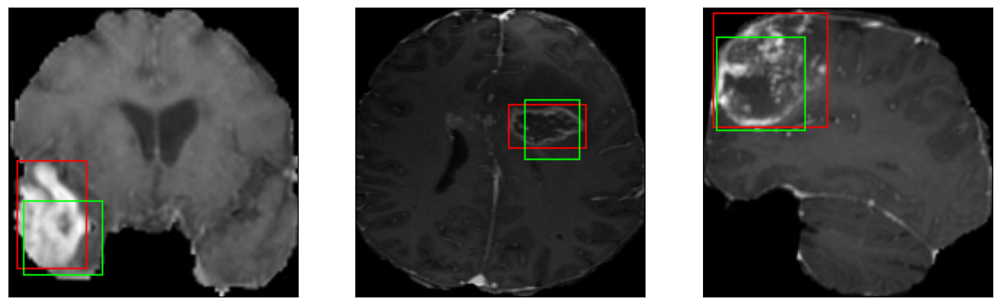

50/50 [==============================] - 7s 146ms/step - loss: 4.4842 - IoU: 0.6277 - val_loss: 6.3784 - val_IoU: 0.5120
Epoch 60/100
7/7 [==============================] - 0s 39ms/step


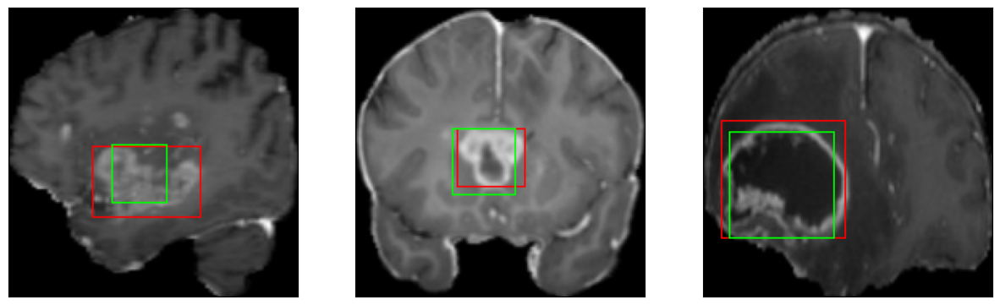

50/50 [==============================] - 8s 151ms/step - loss: 4.7662 - IoU: 0.6199 - val_loss: 4.5262 - val_IoU: 0.6579
Epoch 61/100
7/7 [==============================] - 0s 40ms/step


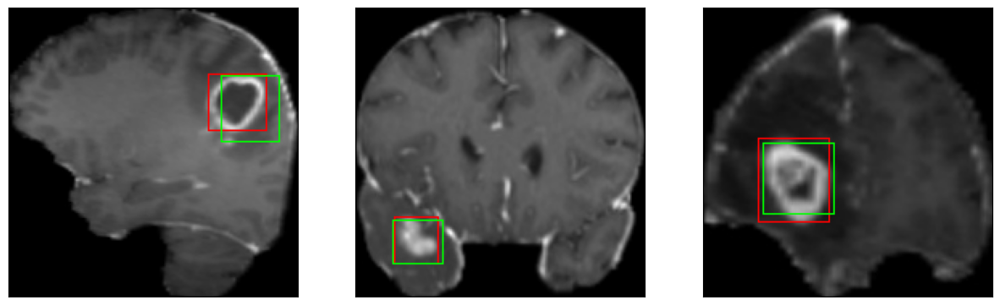

50/50 [==============================] - 8s 155ms/step - loss: 4.4713 - IoU: 0.6392 - val_loss: 4.4496 - val_IoU: 0.6744
Epoch 62/100
7/7 [==============================] - 0s 39ms/step


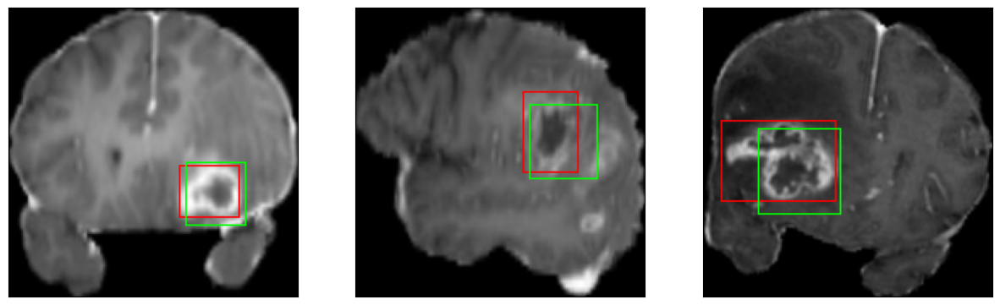

50/50 [==============================] - 8s 158ms/step - loss: 4.5233 - IoU: 0.6373 - val_loss: 4.4078 - val_IoU: 0.6642
Epoch 63/100
7/7 [==============================] - 0s 39ms/step


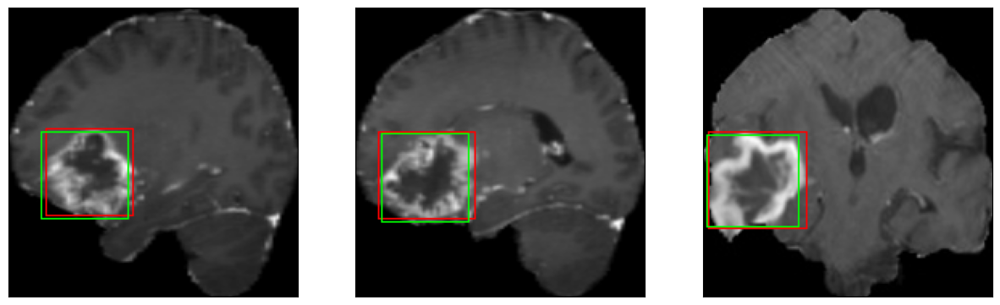

50/50 [==============================] - 7s 147ms/step - loss: 4.3802 - IoU: 0.6406 - val_loss: 4.0195 - val_IoU: 0.6970
Epoch 64/100
7/7 [==============================] - 0s 38ms/step


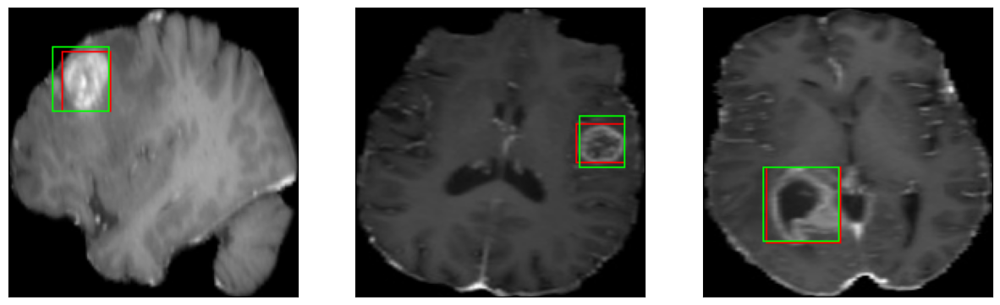

50/50 [==============================] - 7s 150ms/step - loss: 4.4559 - IoU: 0.6416 - val_loss: 3.5337 - val_IoU: 0.7467
Epoch 65/100
7/7 [==============================] - 0s 39ms/step


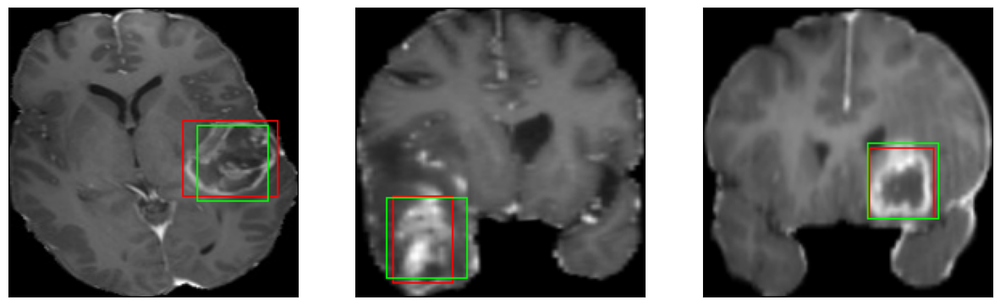

50/50 [==============================] - 7s 146ms/step - loss: 4.4733 - IoU: 0.6346 - val_loss: 3.6024 - val_IoU: 0.7302
Epoch 66/100
7/7 [==============================] - 0s 37ms/step


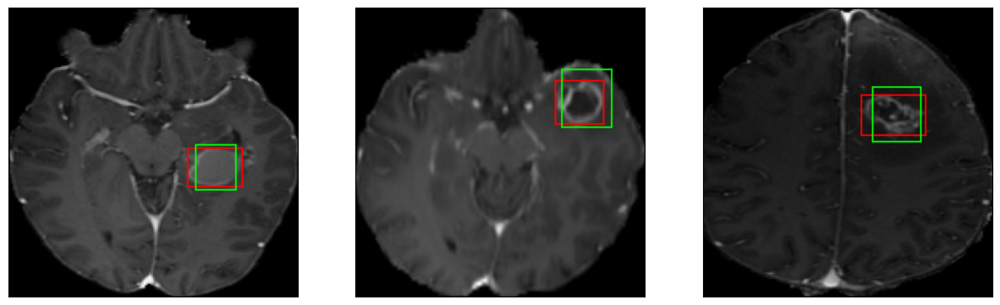

50/50 [==============================] - 8s 153ms/step - loss: 4.3663 - IoU: 0.6363 - val_loss: 5.3797 - val_IoU: 0.6635
Epoch 67/100
7/7 [==============================] - 0s 40ms/step


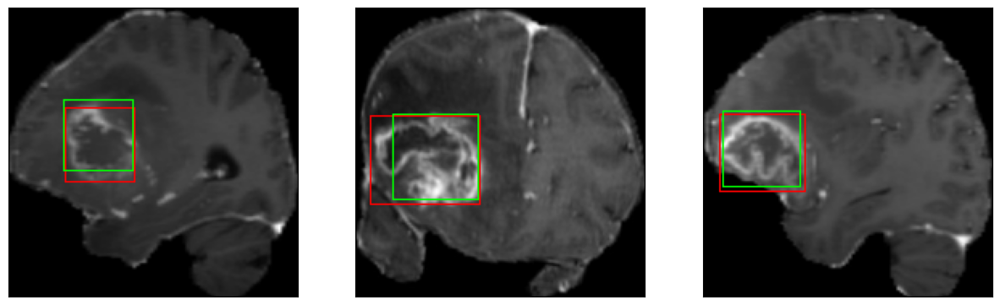

50/50 [==============================] - 7s 144ms/step - loss: 4.4056 - IoU: 0.6398 - val_loss: 4.6974 - val_IoU: 0.6509
Epoch 68/100
7/7 [==============================] - 0s 38ms/step


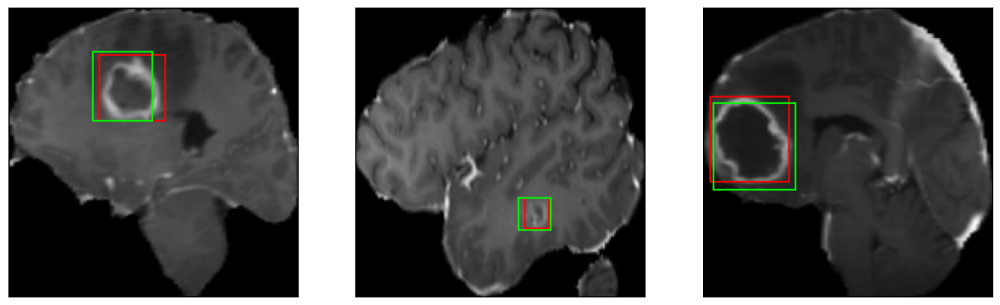

50/50 [==============================] - 7s 150ms/step - loss: 4.4556 - IoU: 0.6310 - val_loss: 4.2078 - val_IoU: 0.6979
Epoch 69/100
7/7 [==============================] - 0s 39ms/step


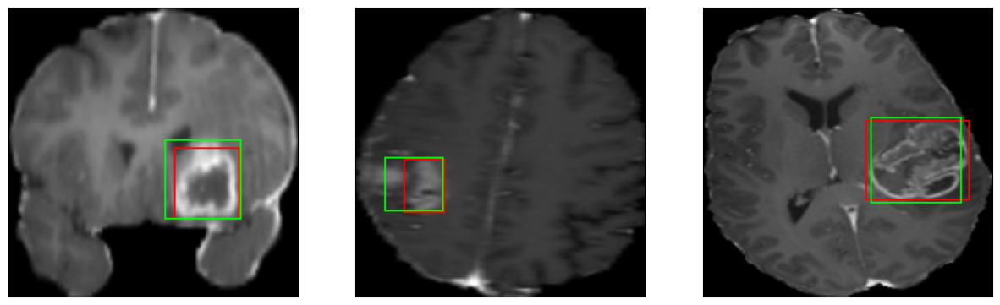

50/50 [==============================] - 7s 145ms/step - loss: 4.2732 - IoU: 0.6410 - val_loss: 4.0405 - val_IoU: 0.6802
Epoch 70/100
7/7 [==============================] - 0s 38ms/step


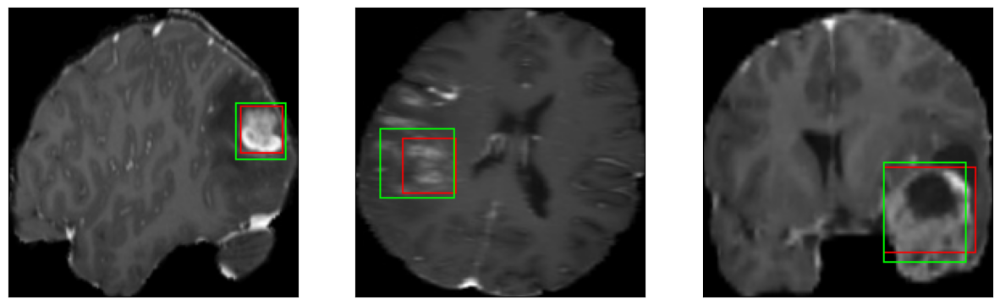

50/50 [==============================] - 7s 144ms/step - loss: 4.2571 - IoU: 0.6433 - val_loss: 5.4244 - val_IoU: 0.6649
Epoch 71/100
7/7 [==============================] - 0s 38ms/step


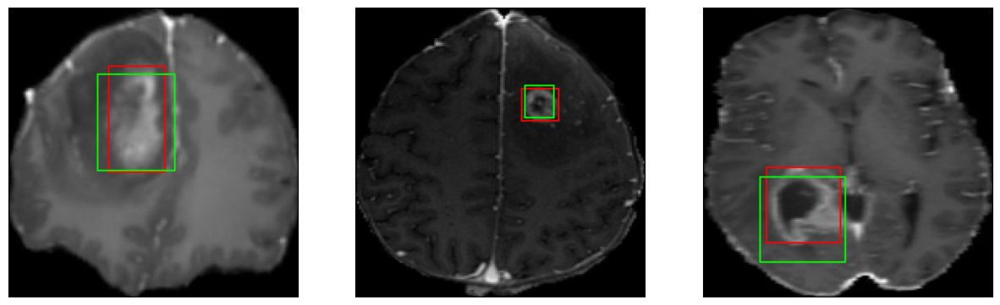

50/50 [==============================] - 8s 155ms/step - loss: 4.3290 - IoU: 0.6363 - val_loss: 4.5040 - val_IoU: 0.6444
Epoch 72/100
7/7 [==============================] - 0s 38ms/step


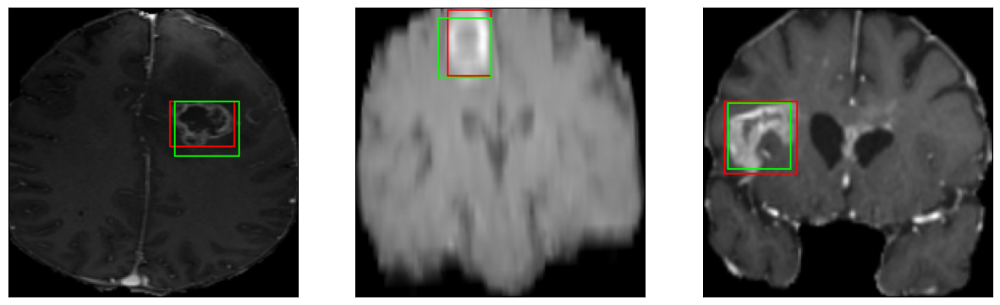

50/50 [==============================] - 7s 145ms/step - loss: 4.1642 - IoU: 0.6401 - val_loss: 3.9083 - val_IoU: 0.7178
Epoch 73/100
7/7 [==============================] - 0s 38ms/step


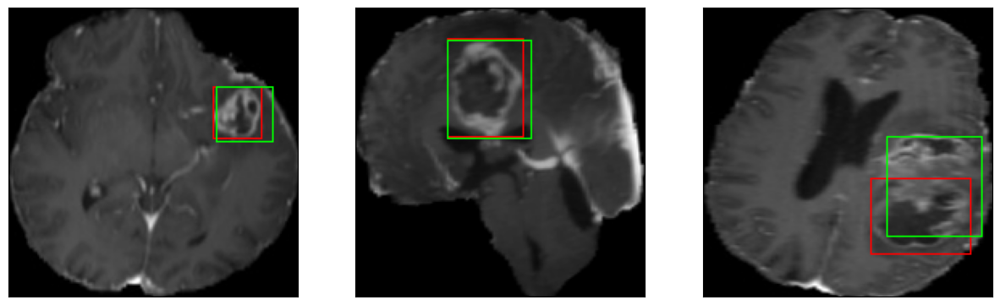

50/50 [==============================] - 8s 155ms/step - loss: 4.1449 - IoU: 0.6436 - val_loss: 3.7505 - val_IoU: 0.7303
Epoch 74/100
7/7 [==============================] - 0s 38ms/step


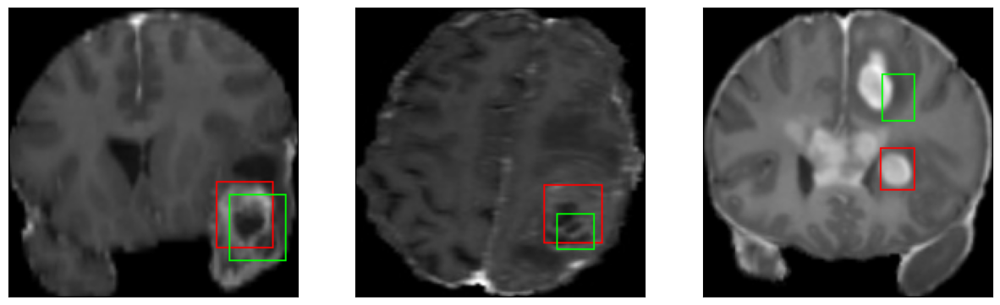

50/50 [==============================] - 7s 144ms/step - loss: 4.1726 - IoU: 0.6432 - val_loss: 6.0592 - val_IoU: 0.5457
Epoch 75/100
7/7 [==============================] - 0s 39ms/step


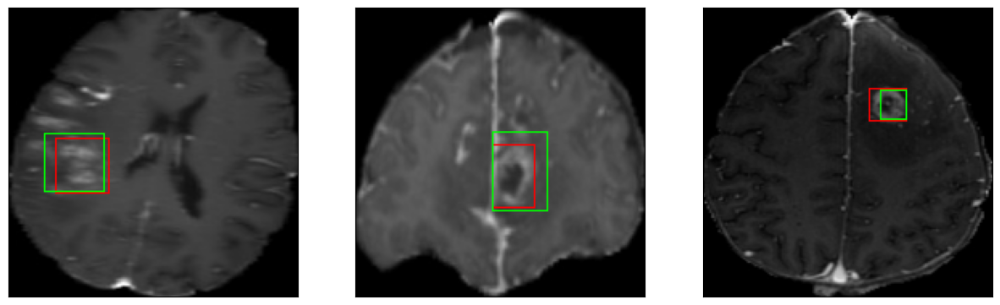

50/50 [==============================] - 7s 141ms/step - loss: 3.9136 - IoU: 0.6515 - val_loss: 3.6380 - val_IoU: 0.7140
Epoch 76/100
7/7 [==============================] - 0s 39ms/step


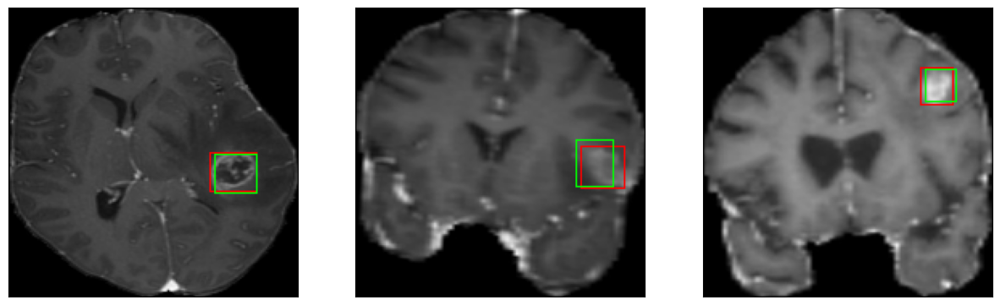

50/50 [==============================] - 8s 159ms/step - loss: 3.8040 - IoU: 0.6595 - val_loss: 3.9507 - val_IoU: 0.7010
Epoch 77/100
7/7 [==============================] - 0s 39ms/step


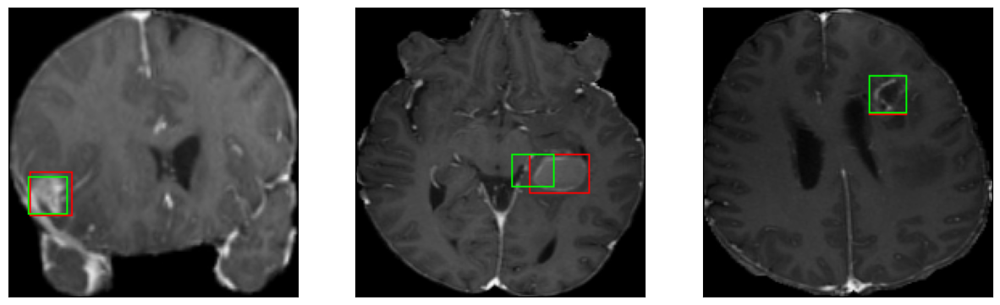

50/50 [==============================] - 7s 144ms/step - loss: 3.7910 - IoU: 0.6614 - val_loss: 4.4805 - val_IoU: 0.6368
Epoch 78/100
7/7 [==============================] - 0s 39ms/step


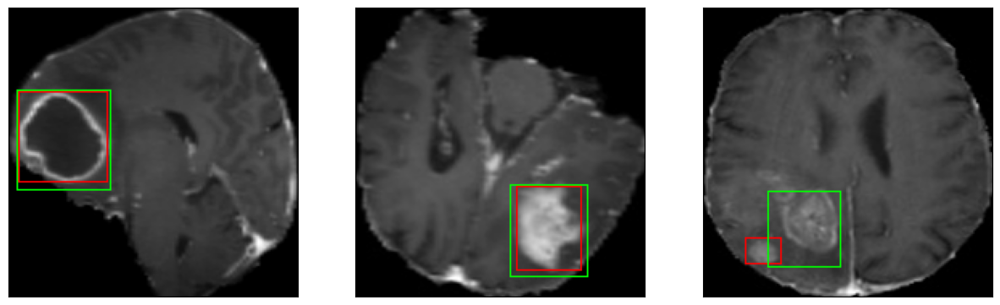

50/50 [==============================] - 7s 144ms/step - loss: 3.9937 - IoU: 0.6455 - val_loss: 4.6727 - val_IoU: 0.6839
Epoch 79/100
7/7 [==============================] - 0s 39ms/step


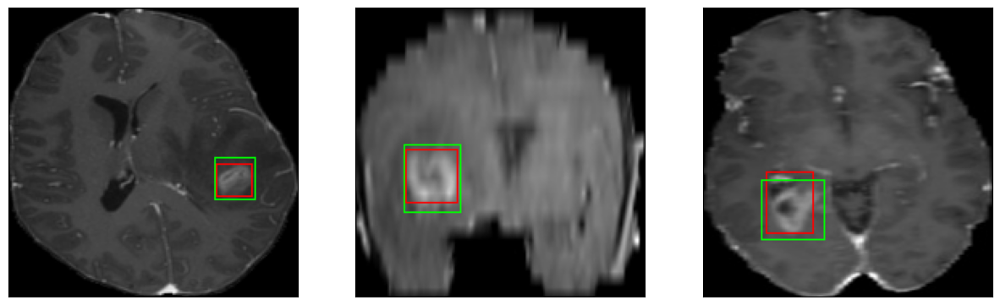

50/50 [==============================] - 8s 153ms/step - loss: 3.9379 - IoU: 0.6465 - val_loss: 4.6209 - val_IoU: 0.6911
Epoch 80/100
7/7 [==============================] - 0s 39ms/step


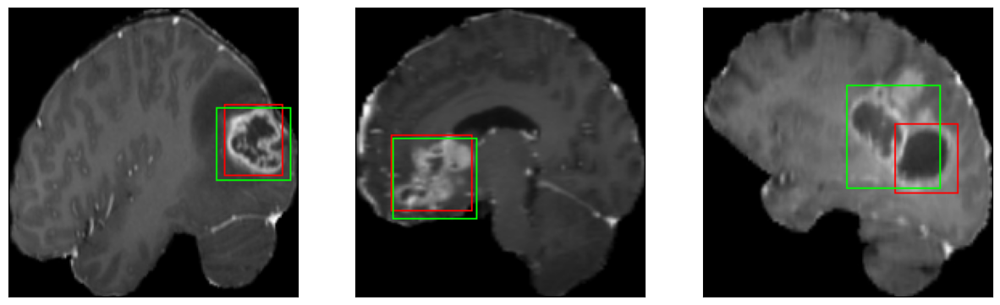

50/50 [==============================] - 7s 146ms/step - loss: 3.8869 - IoU: 0.6529 - val_loss: 4.6256 - val_IoU: 0.6699
Epoch 81/100
7/7 [==============================] - 0s 38ms/step


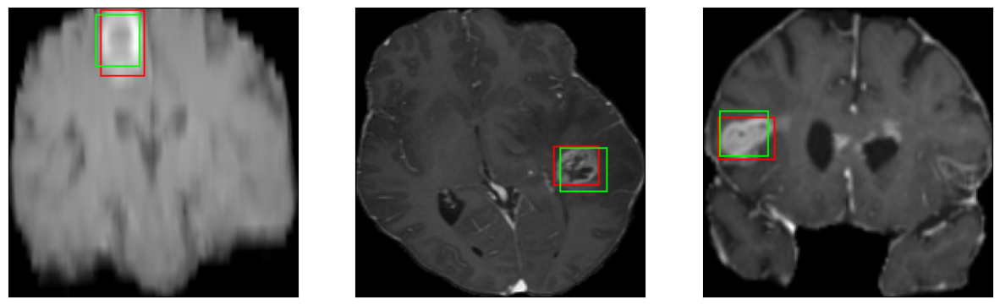

50/50 [==============================] - 7s 148ms/step - loss: 3.9875 - IoU: 0.6483 - val_loss: 3.7670 - val_IoU: 0.7206
Epoch 82/100
7/7 [==============================] - 0s 39ms/step


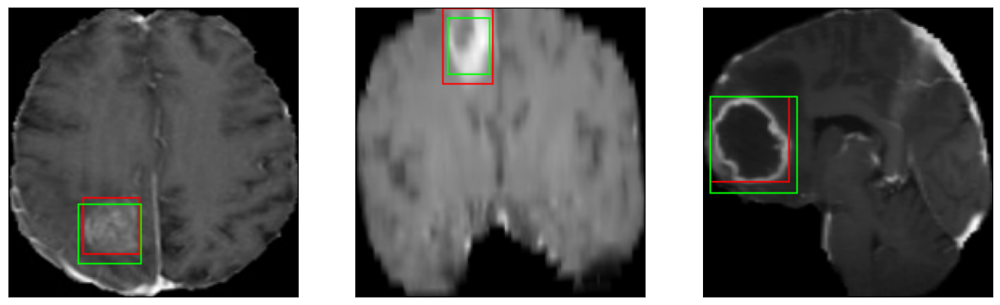

50/50 [==============================] - 7s 144ms/step - loss: 3.5833 - IoU: 0.6728 - val_loss: 4.7378 - val_IoU: 0.6954
Epoch 83/100
7/7 [==============================] - 0s 38ms/step


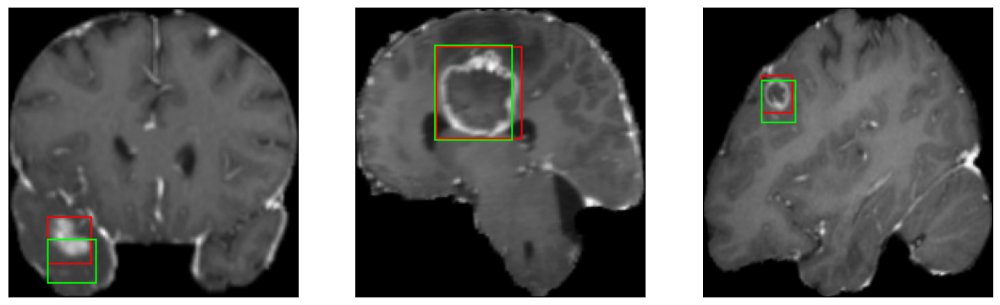

50/50 [==============================] - 7s 141ms/step - loss: 4.0420 - IoU: 0.6368 - val_loss: 4.2504 - val_IoU: 0.6586
Epoch 84/100
7/7 [==============================] - 0s 39ms/step


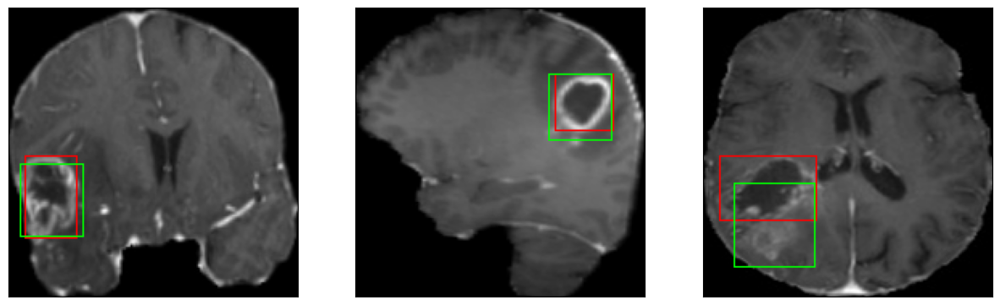

50/50 [==============================] - 8s 156ms/step - loss: 3.6463 - IoU: 0.6660 - val_loss: 4.1033 - val_IoU: 0.6558
Epoch 85/100
7/7 [==============================] - 0s 40ms/step


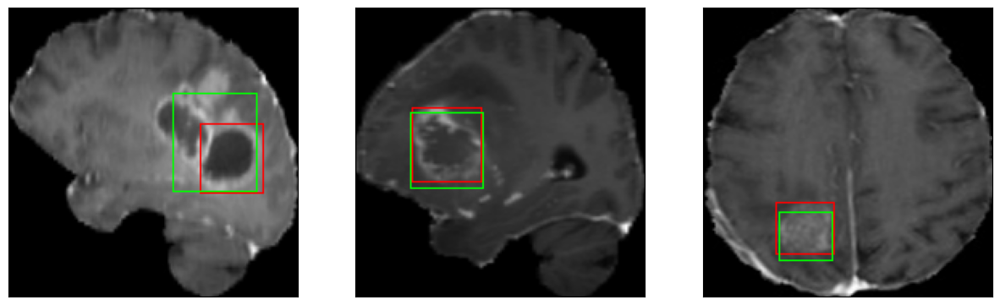

50/50 [==============================] - 7s 146ms/step - loss: 3.7905 - IoU: 0.6595 - val_loss: 4.0684 - val_IoU: 0.6789
Epoch 86/100
7/7 [==============================] - 0s 39ms/step


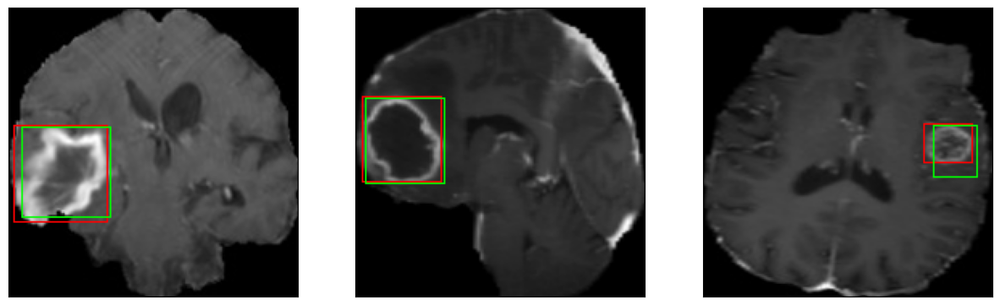

50/50 [==============================] - 7s 142ms/step - loss: 3.5852 - IoU: 0.6688 - val_loss: 3.5834 - val_IoU: 0.7296
Epoch 87/100
7/7 [==============================] - 0s 39ms/step


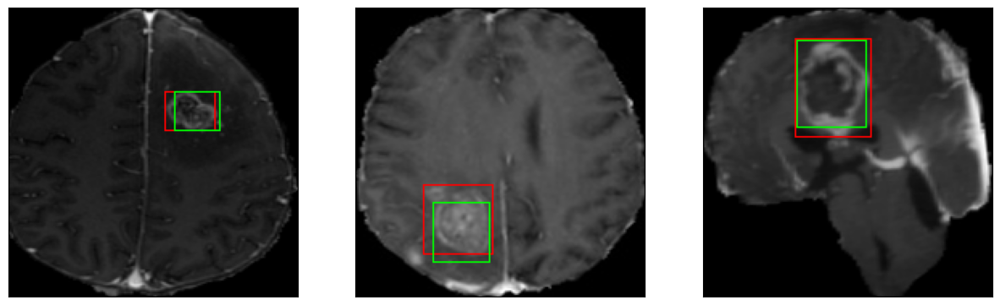

50/50 [==============================] - 8s 152ms/step - loss: 3.6880 - IoU: 0.6623 - val_loss: 4.9274 - val_IoU: 0.6184
Epoch 88/100
7/7 [==============================] - 0s 39ms/step


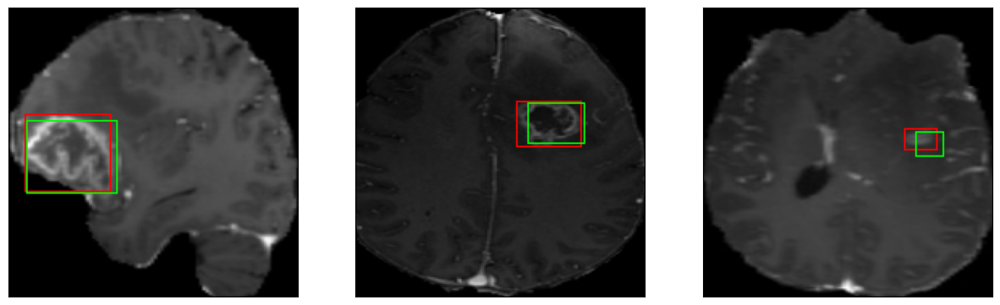

50/50 [==============================] - 7s 141ms/step - loss: 3.6949 - IoU: 0.6567 - val_loss: 4.6093 - val_IoU: 0.6225
Epoch 89/100
7/7 [==============================] - 0s 42ms/step


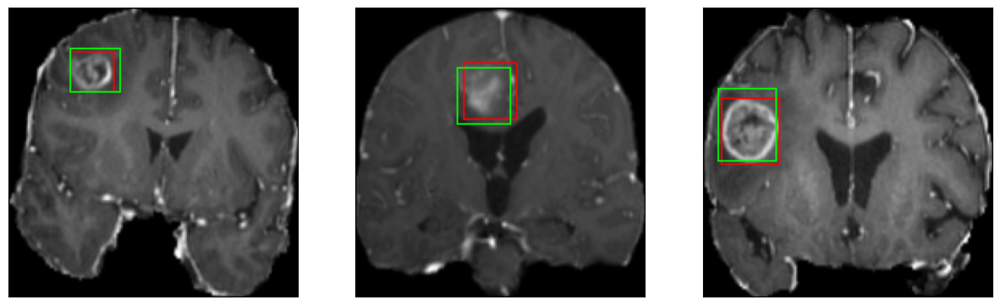

50/50 [==============================] - 8s 152ms/step - loss: 3.6341 - IoU: 0.6628 - val_loss: 3.8858 - val_IoU: 0.7143
Epoch 90/100
7/7 [==============================] - 0s 39ms/step


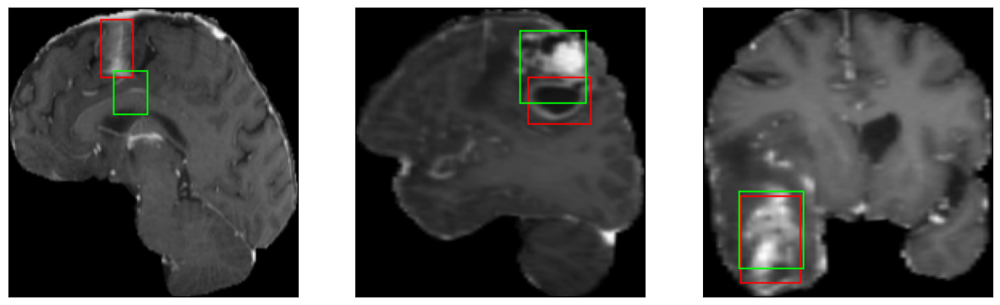

50/50 [==============================] - 7s 141ms/step - loss: 3.7622 - IoU: 0.6530 - val_loss: 4.0078 - val_IoU: 0.7071
Epoch 91/100
7/7 [==============================] - 0s 38ms/step


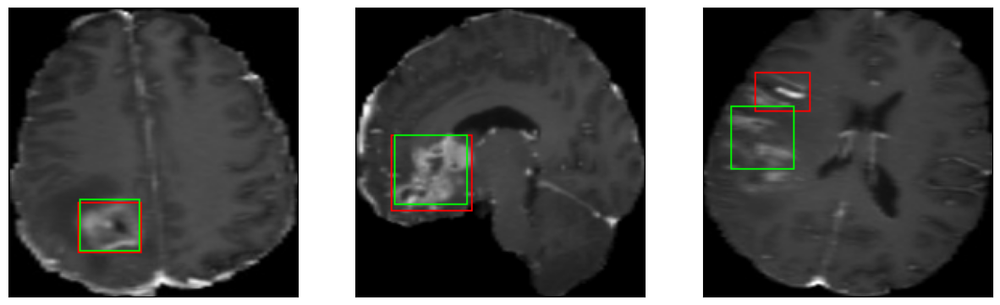

50/50 [==============================] - 8s 154ms/step - loss: 3.5860 - IoU: 0.6623 - val_loss: 3.6249 - val_IoU: 0.7194
Epoch 92/100
7/7 [==============================] - 0s 38ms/step


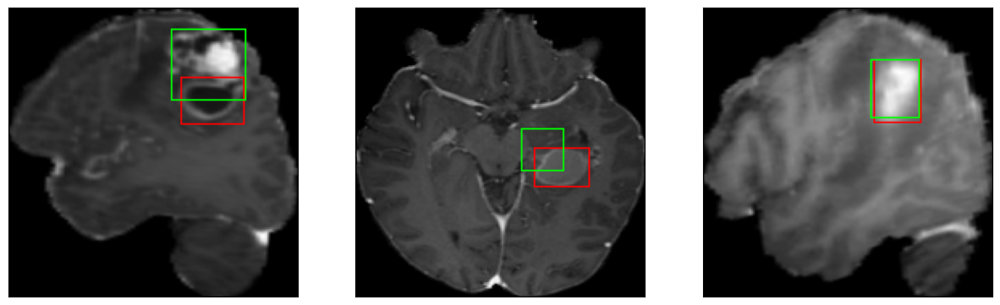

50/50 [==============================] - 7s 141ms/step - loss: 3.5244 - IoU: 0.6675 - val_loss: 3.5530 - val_IoU: 0.7326
Epoch 93/100
7/7 [==============================] - 0s 39ms/step


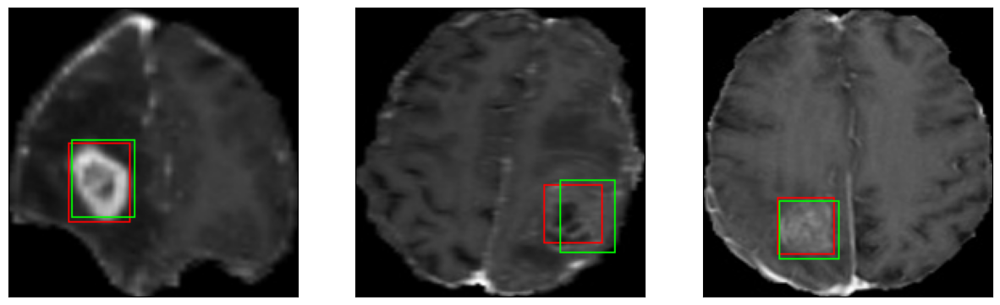

50/50 [==============================] - 8s 166ms/step - loss: 3.4610 - IoU: 0.6716 - val_loss: 4.4222 - val_IoU: 0.6353
Epoch 94/100
7/7 [==============================] - 0s 39ms/step


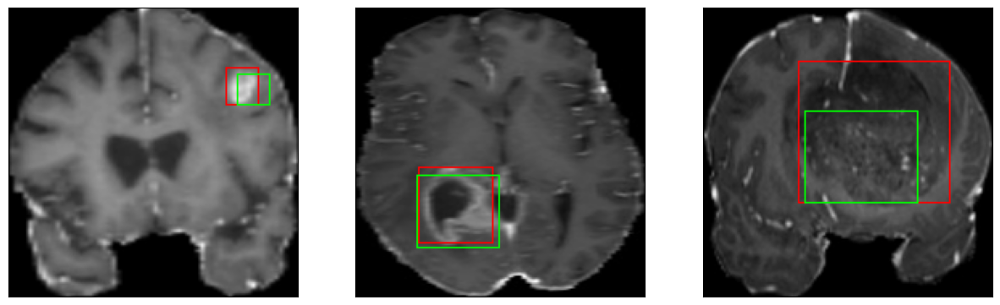

50/50 [==============================] - 7s 145ms/step - loss: 3.7085 - IoU: 0.6631 - val_loss: 4.0464 - val_IoU: 0.6845
Epoch 95/100
7/7 [==============================] - 0s 38ms/step


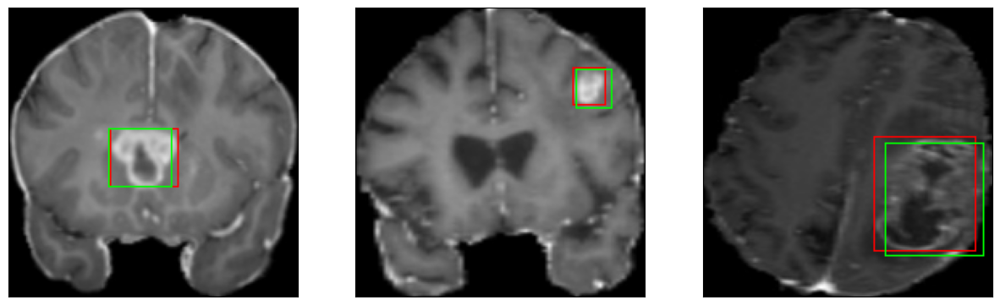

50/50 [==============================] - 8s 151ms/step - loss: 3.4532 - IoU: 0.6673 - val_loss: 3.4648 - val_IoU: 0.7410
Epoch 96/100
7/7 [==============================] - 0s 38ms/step


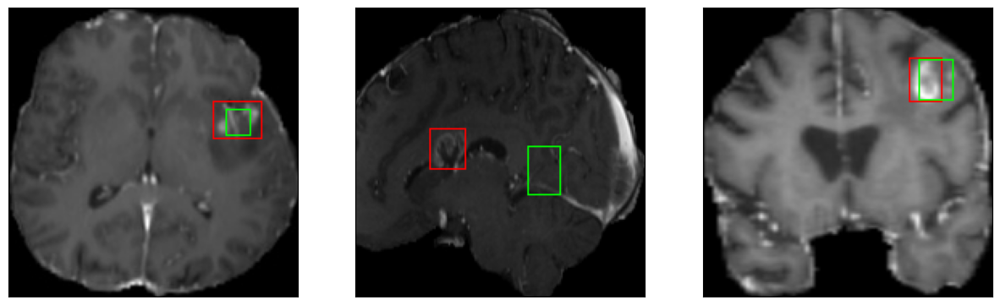

50/50 [==============================] - 8s 154ms/step - loss: 3.3657 - IoU: 0.6792 - val_loss: 3.7598 - val_IoU: 0.7080
Epoch 97/100
7/7 [==============================] - 0s 39ms/step


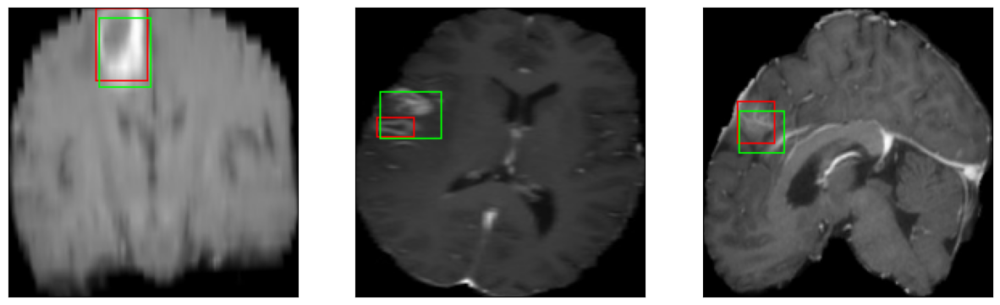

50/50 [==============================] - 7s 146ms/step - loss: 3.5154 - IoU: 0.6669 - val_loss: 5.3047 - val_IoU: 0.5566
Epoch 98/100
7/7 [==============================] - 0s 37ms/step


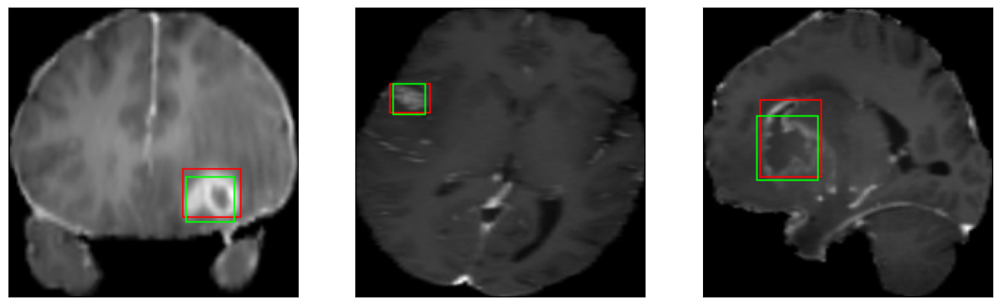

50/50 [==============================] - 7s 150ms/step - loss: 3.5155 - IoU: 0.6632 - val_loss: 4.8268 - val_IoU: 0.6382
Epoch 99/100
7/7 [==============================] - 0s 39ms/step


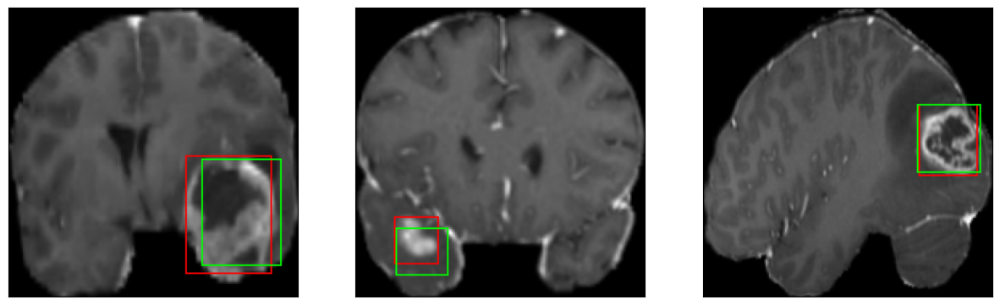

50/50 [==============================] - 7s 142ms/step - loss: 3.7105 - IoU: 0.6549 - val_loss: 3.8002 - val_IoU: 0.6990
Epoch 100/100
7/7 [==============================] - 0s 38ms/step


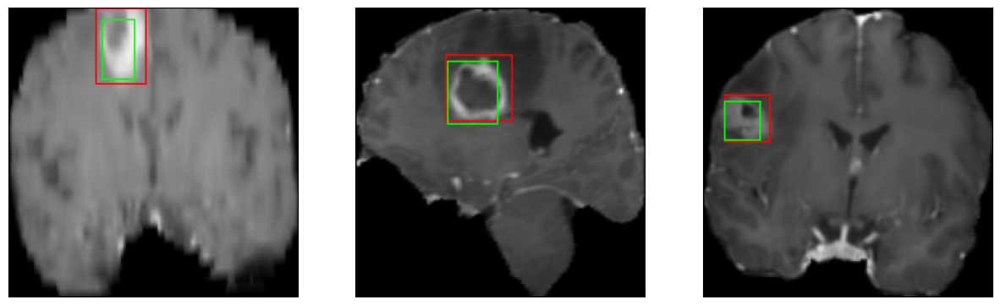

50/50 [==============================] - 8s 156ms/step - loss: 3.4884 - IoU: 0.6682 - val_loss: 4.6600 - val_IoU: 0.6558


In [26]:
model.fit(
        train_dataset,
        epochs=100,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [ ]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
        
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
